Project Purpose: 透過 LAKE-RED 的 image generation 模型去生成其他偽裝圖片，再比較物件偵測預訓練模型跟fineutune模型對這些偽裝圖片的辨識效果。  

* 先對一般圖片資料集 (沒有加合成的) 進行訓練。  
資料集來自 [TW0521 Obstacle-Dataset](https://github.com/TW0521/Obstacle-Dataset?tab=readme-ov-file)
* 因為有 image 跟 mask，所以我用 Segfromer 模型進行 Image segmentation 的測試，網路上有怎麼 finetune 的教學，我有拿來參考。  

[ref](https://github.com/roboflow/notebooks?tab=readme-ov-file)  
[finetune example from colab](https://colab.research.google.com/github/roboflow-ai/notebooks/blob/main/notebooks/train-segformer-segmentation-on-custom-data.ipynb#scrollTo=22a98726)  
[finetune example from colab - 2](https://colab.research.google.com/github/NielsRogge/Transformers-Tutorials/blob/master/SegFormer/Fine_tune_SegFormer_on_custom_dataset.ipynb)

Install depencies

In [1]:
!pip install -q pytorch-lightning==1.9.0
!pip install -q transformers==4.46.2 datasets==2.21.0 roboflow==1.1.49
!pip install -q evaluate

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 825.8/825.8 kB 14.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 3.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 92.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 88.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 40.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 13.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 6.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 88.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 962.5/962.5 kB 56.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━

In [2]:
import pytorch_lightning as pl
from pytorch_lightning.callbacks.early_stopping import EarlyStopping
from pytorch_lightning.callbacks.model_checkpoint import ModelCheckpoint
from pytorch_lightning.loggers import CSVLogger
from transformers import SegformerFeatureExtractor, SegformerForSemanticSegmentation
from datasets import load_metric
import torch
from torch import nn
from torch.utils.data import Dataset, DataLoader
import os
from PIL import Image
import numpy as np
import random
from tqdm import tqdm
import matplotlib.pyplot as plt

%matplotlib inline

training on custom dataset

In [3]:
!unzip original.zip

Archive:  original.zip
   creating: original/
   creating: original/images/
  inflating: original/images/000000000064.jpg  
  inflating: original/images/000000000074.jpg  
  inflating: original/images/000000002753.jpg  
  inflating: original/images/000000002951.jpg  
  inflating: original/images/000000005253.jpg  
  inflating: original/images/000000006016.jpg  
  inflating: original/images/000000009091.jpg  
  inflating: original/images/000000013637.jpg  
  inflating: original/images/000000016805.jpg  
  inflating: original/images/000000042366.jpg  
  inflating: original/images/000000084200.jpg  
  inflating: original/images/000000167422.jpg  
  inflating: original/images/000000367969.jpg  
  inflating: original/images/000000379259.jpg  
  inflating: original/images/000000382715.jpg  
  inflating: original/images/000000385972.jpg  
  inflating: original/images/000000393266.jpg  
  inflating: original/images/000000418092.jpg  
  inflating: original/images/000000425161.jpg  
  inflating:

draw mask and assign labels

In [4]:
id2label = {
    0: "stop_sign",
    1: "person",
    2: "bicycle",
    3: "bus",
    4: "truck",
    5: "car",
    6: "motorbike",
    7: "reflective_cone",
    8: "ashcan",
    9: "warning_column",
    10: "spherical_roadblock",
    11: "pole",
    12: "dog",
    13: "tricycle",
    14: "fire_hydrant"
}
label2id = {v: k for k, v in id2label.items()}

我突發奇想，想看看直接用 bbox 的範圍當作 segmentation，但這樣訓練結果很奇怪。  
OK 🤡

✔️ Used class_id 5(car) at [52, 387, 228, 545]
✔️ Used class_id 4(truck) at [51, 353, 177, 413]
✔️ Used class_id 0(stop_sign) at [115, 226, 152, 301]
✔️ Used class_id 11(pole) at [160, 224, 229, 634]


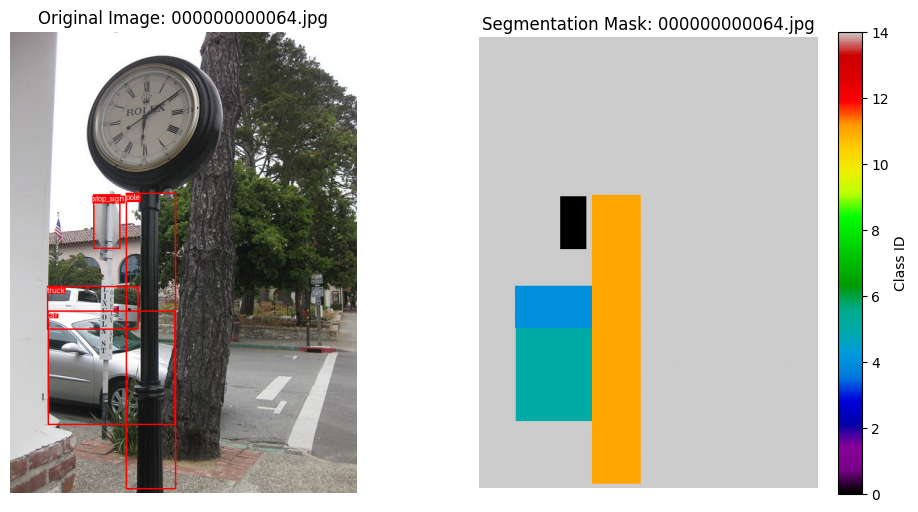

✔️ Used class_id 12(dog) at [61, 276, 358, 379]
✔️ Used class_id 2(bicycle) at [0, 0, 164, 320]


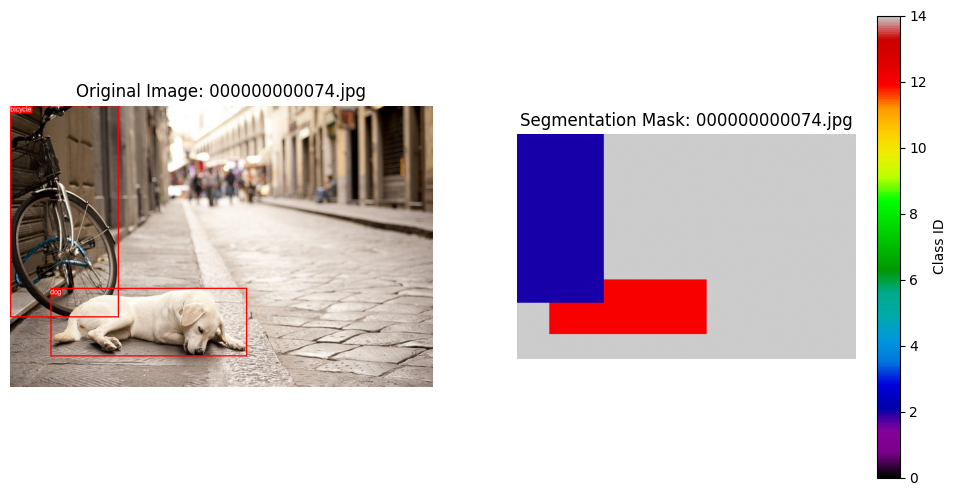

✔️ Used class_id 12(dog) at [106, 34, 468, 342]


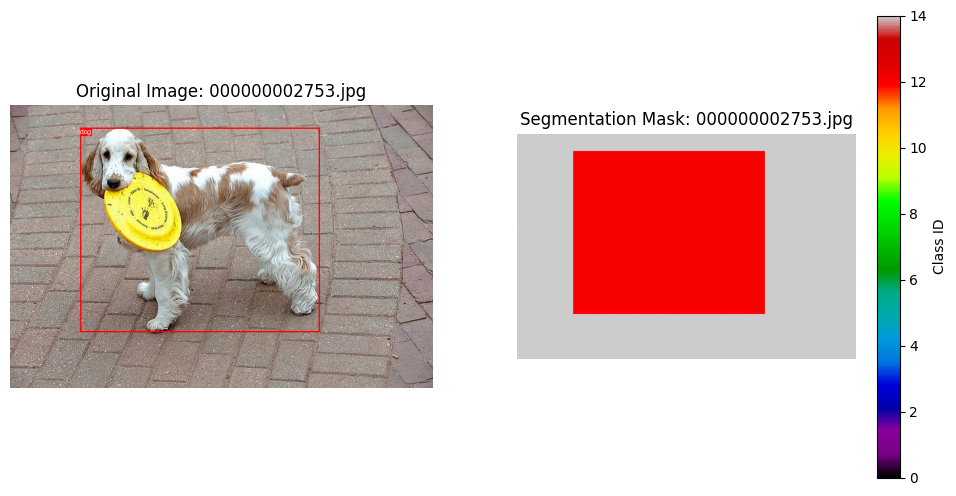

✔️ Used class_id 0(stop_sign) at [151, 12, 431, 286]
✔️ Used class_id 1(person) at [587, 466, 614, 512]
✔️ Used class_id 1(person) at [568, 466, 585, 505]
✔️ Used class_id 5(car) at [476, 466, 535, 508]
✔️ Used class_id 5(car) at [419, 471, 515, 512]
✔️ Used class_id 1(person) at [25, 452, 47, 511]
✔️ Used class_id 5(car) at [333, 460, 376, 487]
✔️ Used class_id 5(car) at [526, 468, 542, 498]
✔️ Used class_id 0(stop_sign) at [130, 396, 158, 429]
✔️ Used class_id 5(car) at [495, 463, 532, 492]
✔️ Used class_id 5(car) at [528, 467, 545, 490]
✔️ Used class_id 11(pole) at [256, 286, 304, 512]


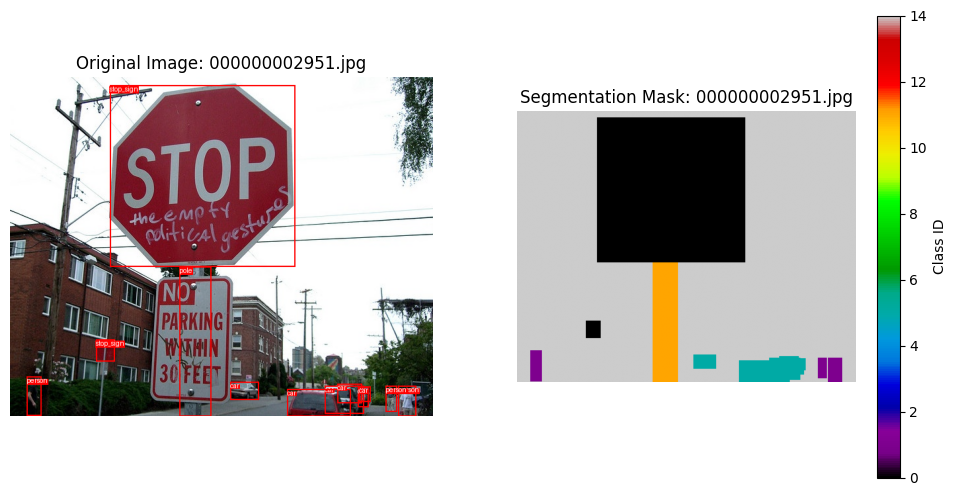

✔️ Used class_id 0(stop_sign) at [368, 86, 481, 183]


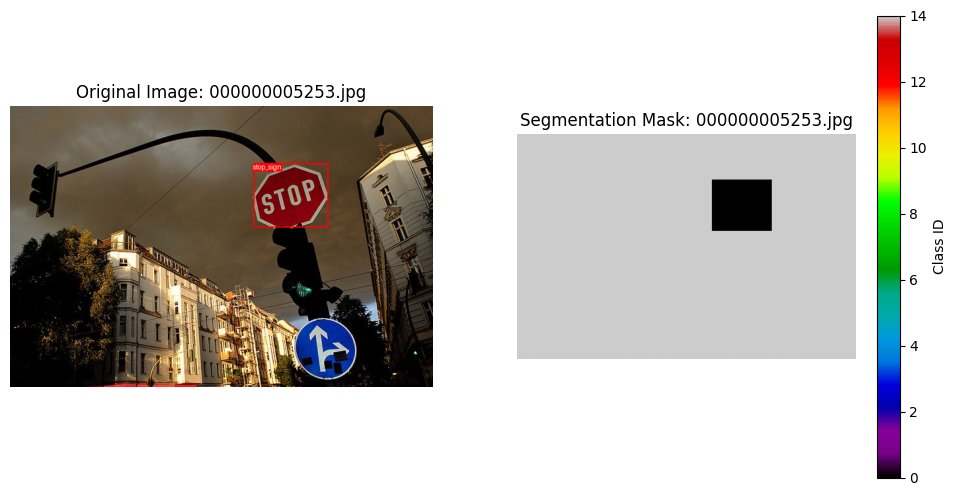

✔️ Used class_id 14(fire_hydrant) at [252, 75, 370, 355]


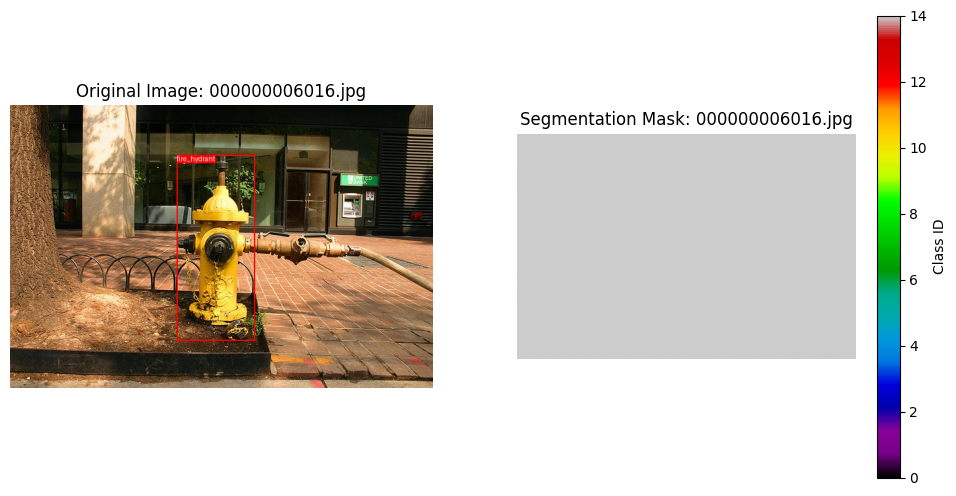

✔️ Used class_id 0(stop_sign) at [136, 129, 351, 385]
✔️ Used class_id 11(pole) at [158, 513, 238, 640]


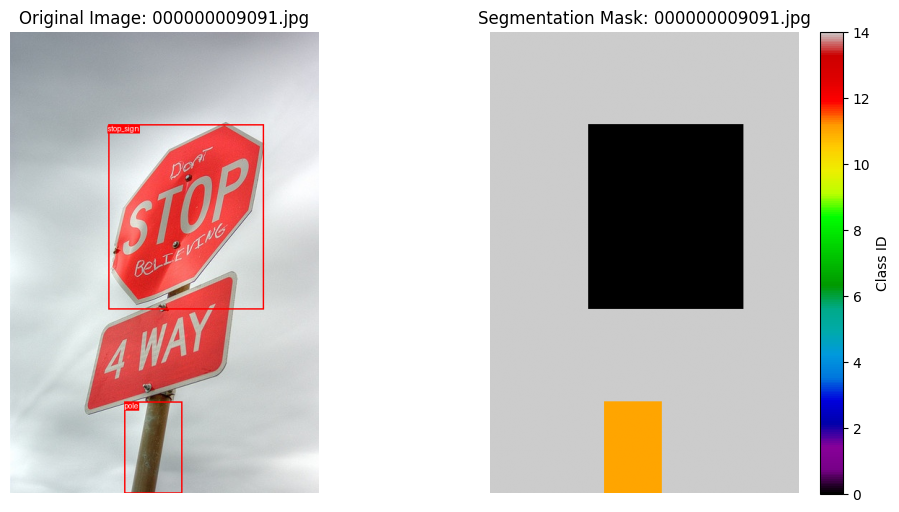

✔️ Used class_id 1(person) at [250, 97, 387, 257]
✔️ Used class_id 14(fire_hydrant) at [62, 146, 171, 375]
✔️ Used class_id 11(pole) at [4, 0, 45, 217]


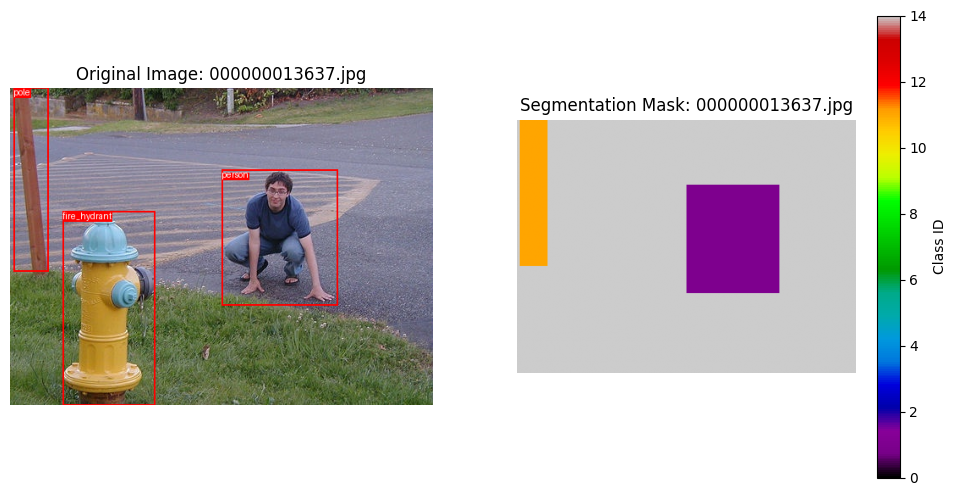

✔️ Used class_id 5(car) at [0, 7, 165, 87]
✔️ Used class_id 5(car) at [331, 1, 638, 88]
✔️ Used class_id 14(fire_hydrant) at [335, 139, 533, 433]
✔️ Used class_id 5(car) at [600, 20, 640, 137]


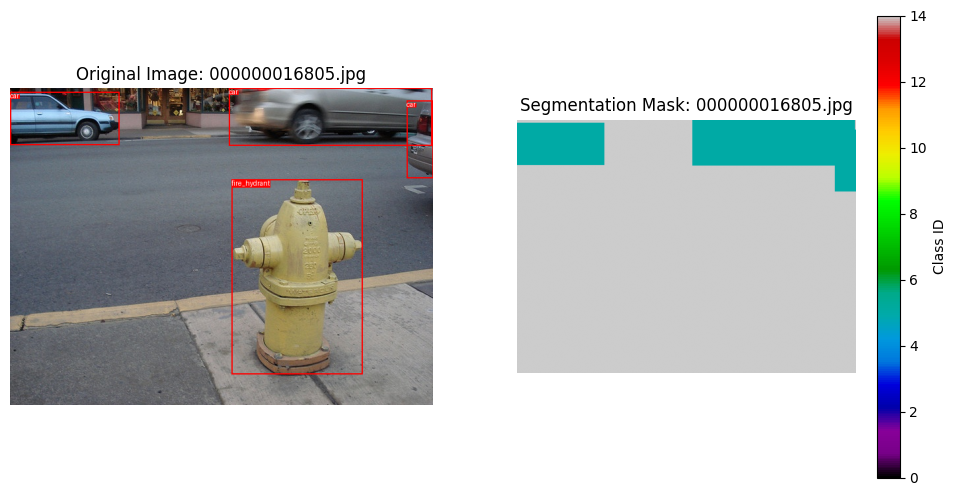

✔️ Used class_id 14(fire_hydrant) at [168, 33, 257, 170]


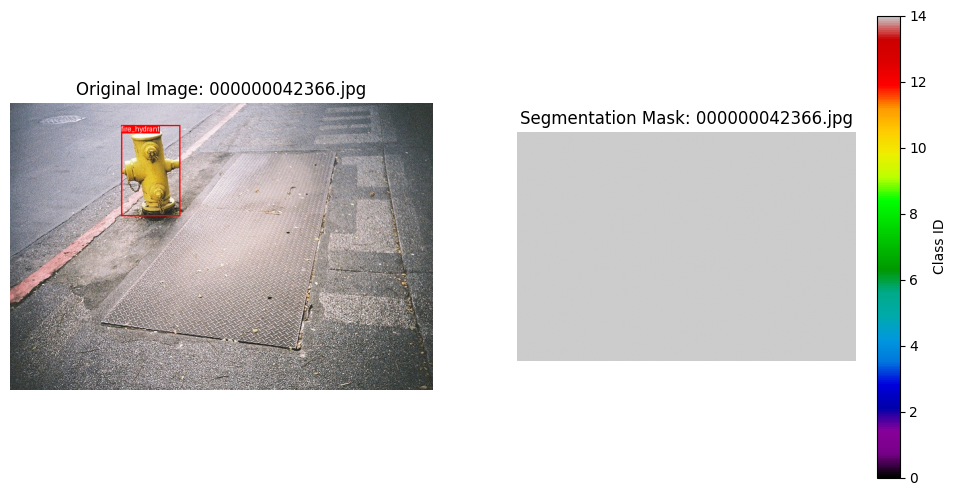

✔️ Used class_id 14(fire_hydrant) at [239, 52, 394, 367]


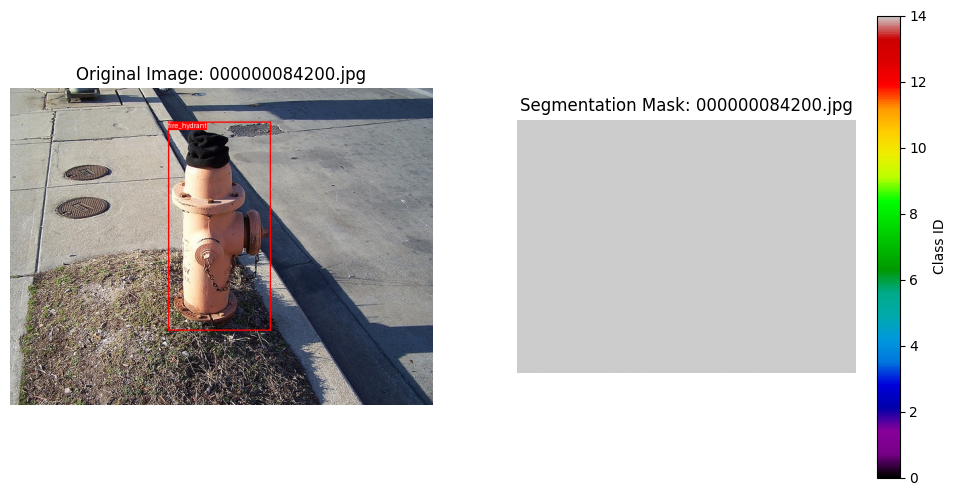

✔️ Used class_id 14(fire_hydrant) at [263, 359, 412, 640]


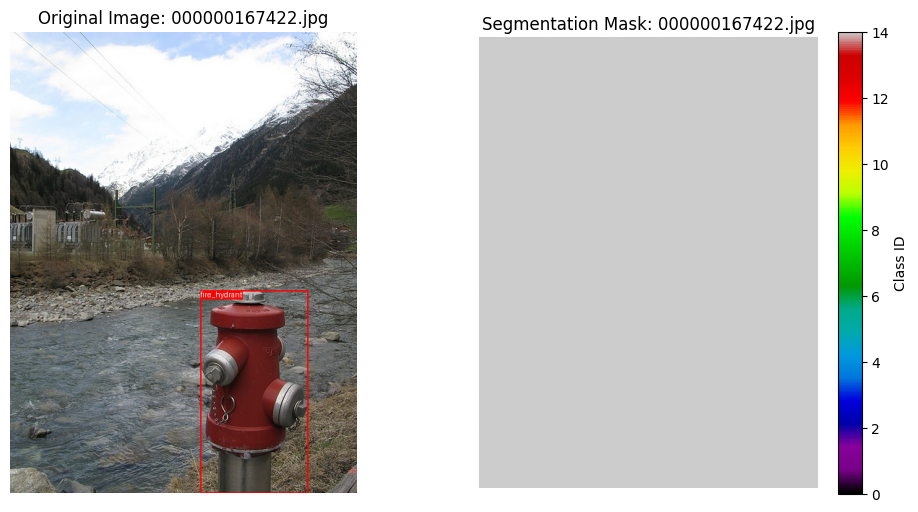

✔️ Used class_id 5(car) at [464, 246, 529, 271]
✔️ Used class_id 5(car) at [8, 255, 21, 266]
✔️ Used class_id 1(person) at [179, 207, 296, 465]
✔️ Used class_id 1(person) at [353, 230, 373, 291]
✔️ Used class_id 1(person) at [72, 241, 87, 281]
✔️ Used class_id 1(person) at [61, 254, 73, 280]
✔️ Used class_id 1(person) at [369, 232, 387, 289]
✔️ Used class_id 11(pole) at [134, 165, 149, 288]


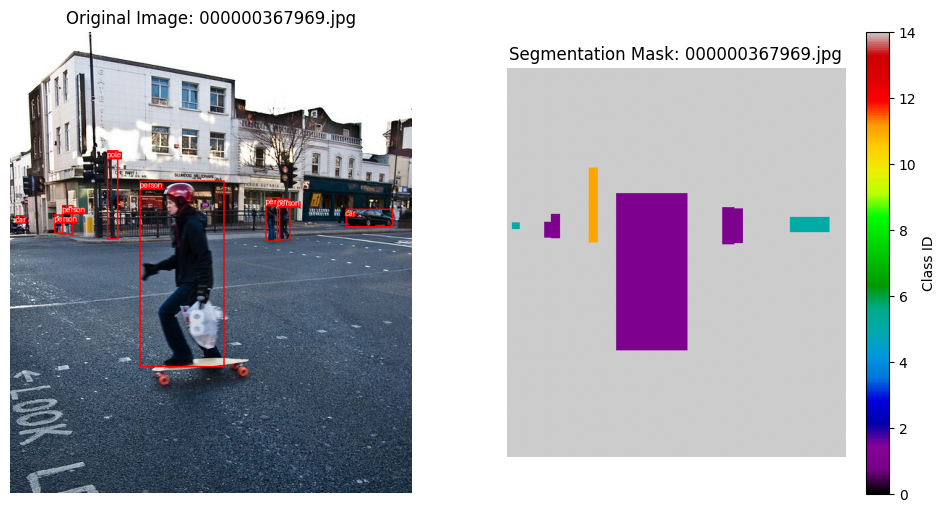

✔️ Used class_id 5(car) at [247, 329, 270, 352]
✔️ Used class_id 5(car) at [133, 341, 191, 391]
✔️ Used class_id 5(car) at [217, 330, 258, 365]
✔️ Used class_id 5(car) at [88, 324, 139, 362]
✔️ Used class_id 1(person) at [171, 335, 231, 512]
✔️ Used class_id 5(car) at [0, 360, 120, 469]
✔️ Used class_id 5(car) at [0, 337, 51, 365]
✔️ Used class_id 5(car) at [265, 324, 284, 335]
✔️ Used class_id 5(car) at [255, 325, 279, 346]
✔️ Used class_id 5(car) at [279, 322, 296, 334]
✔️ Used class_id 11(pole) at [47, 335, 68, 494]


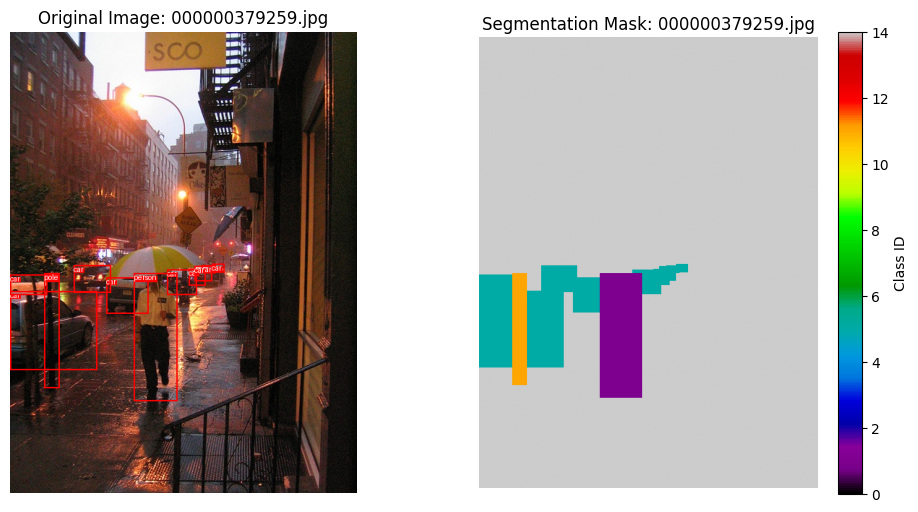

✔️ Used class_id 2(bicycle) at [19, 240, 62, 294]
✔️ Used class_id 5(car) at [296, 220, 423, 309]
✔️ Used class_id 5(car) at [258, 205, 325, 245]
✔️ Used class_id 1(person) at [128, 170, 251, 547]
✔️ Used class_id 1(person) at [296, 199, 316, 250]
✔️ Used class_id 1(person) at [233, 197, 251, 253]
✔️ Used class_id 1(person) at [339, 184, 345, 204]
✔️ Used class_id 1(person) at [247, 200, 260, 260]
✔️ Used class_id 1(person) at [45, 206, 80, 277]
✔️ Used class_id 1(person) at [360, 184, 369, 215]
✔️ Used class_id 1(person) at [378, 184, 384, 209]
✔️ Used class_id 1(person) at [325, 202, 341, 224]
✔️ Used class_id 1(person) at [349, 205, 357, 217]
✔️ Used class_id 1(person) at [142, 198, 160, 238]
✔️ Used class_id 1(person) at [212, 200, 228, 225]
✔️ Used class_id 1(person) at [332, 179, 340, 202]
✔️ Used class_id 1(person) at [82, 184, 394, 245]
✔️ Used class_id 11(pole) at [104, 3, 144, 286]
✔️ Used class_id 11(pole) at [228, 25, 251, 202]


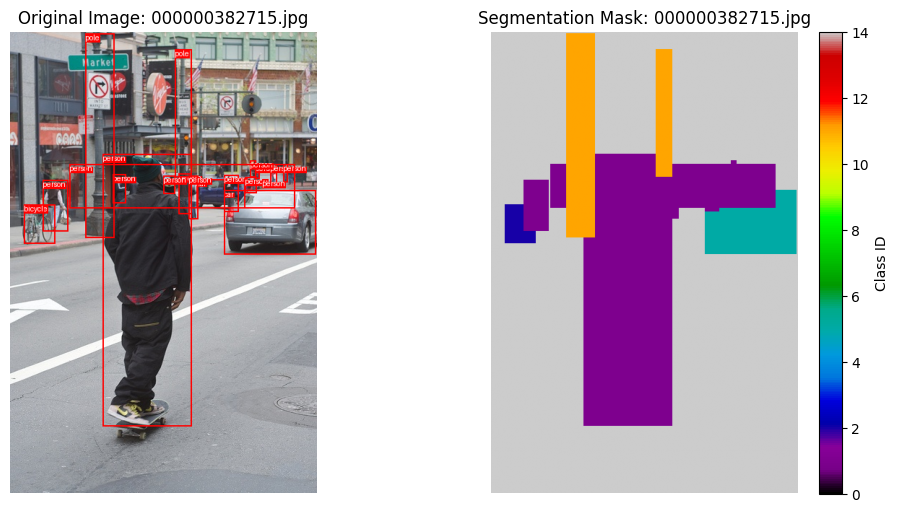

✔️ Used class_id 2(bicycle) at [167, 248, 305, 577]
✔️ Used class_id 5(car) at [80, 134, 109, 156]
✔️ Used class_id 5(car) at [111, 131, 150, 163]
✔️ Used class_id 1(person) at [136, 56, 325, 513]
✔️ Used class_id 5(car) at [70, 137, 85, 152]
✔️ Used class_id 5(car) at [41, 129, 48, 138]
✔️ Used class_id 5(car) at [109, 132, 122, 151]
✔️ Used class_id 4(truck) at [7, 126, 44, 158]
✔️ Used class_id 4(truck) at [51, 125, 80, 148]
✔️ Used class_id 8(ashcan) at [417, 163, 437, 195]
✔️ Used class_id 8(ashcan) at [335, 159, 358, 189]
✔️ Used class_id 11(pole) at [377, 0, 392, 157]


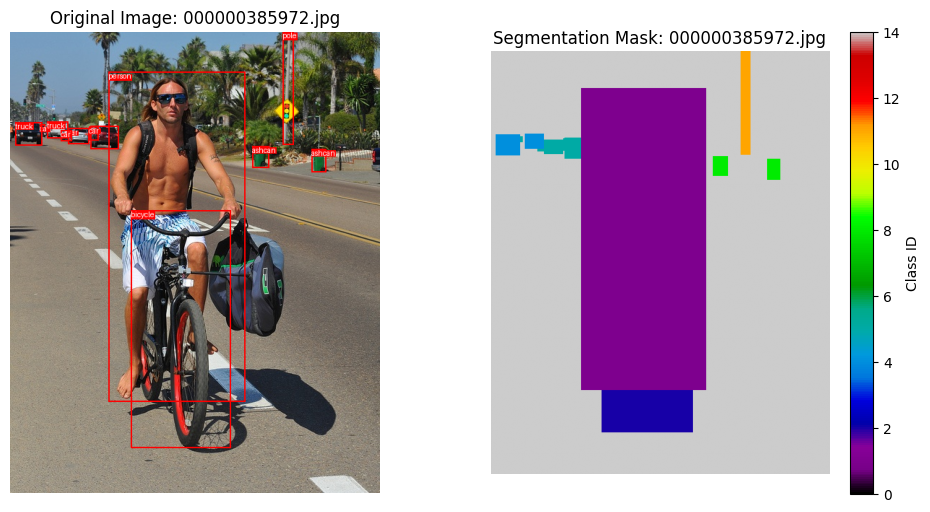

✔️ Used class_id 5(car) at [281, 261, 334, 307]
✔️ Used class_id 5(car) at [327, 265, 337, 286]
✔️ Used class_id 5(car) at [331, 265, 341, 282]
✔️ Used class_id 0(stop_sign) at [472, 133, 530, 191]
✔️ Used class_id 11(pole) at [493, 191, 510, 377]


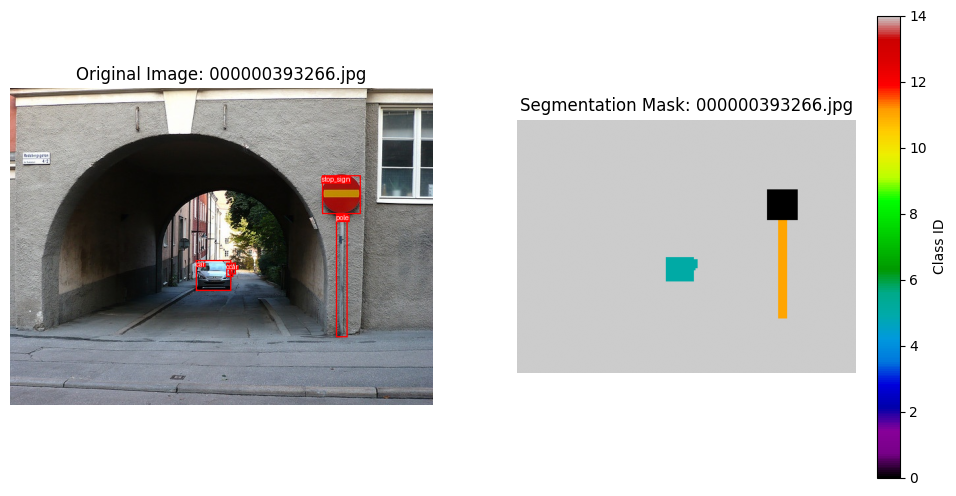

✔️ Used class_id 0(stop_sign) at [57, 20, 144, 107]
✔️ Used class_id 1(person) at [162, 151, 284, 366]
✔️ Used class_id 11(pole) at [92, 106, 116, 366]


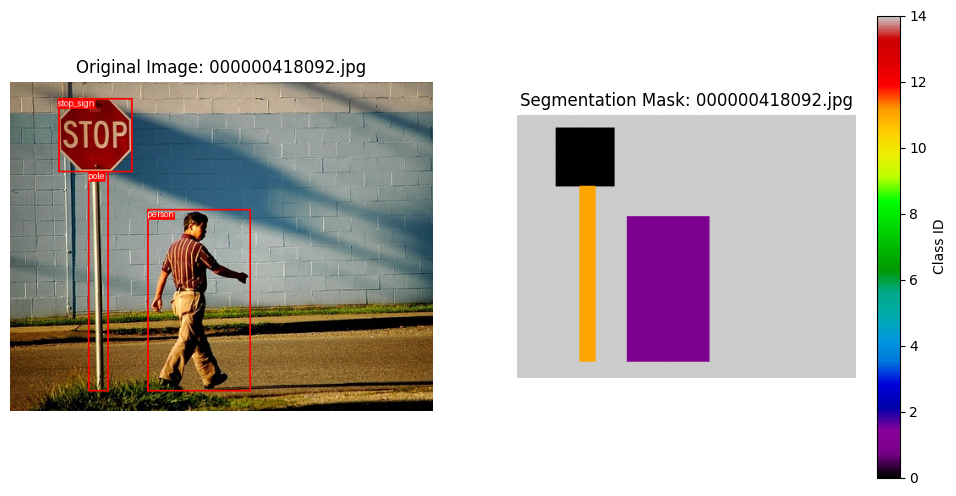

✔️ Used class_id 1(person) at [24, 133, 68, 218]
✔️ Used class_id 1(person) at [362, 162, 374, 177]
✔️ Used class_id 1(person) at [549, 162, 567, 195]
✔️ Used class_id 5(car) at [536, 183, 559, 196]
✔️ Used class_id 1(person) at [59, 188, 69, 199]
✔️ Used class_id 4(truck) at [353, 153, 446, 210]
✔️ Used class_id 4(truck) at [180, 201, 208, 218]
✔️ Used class_id 1(person) at [242, 195, 245, 202]
✔️ Used class_id 4(truck) at [15, 184, 128, 218]
✔️ Used class_id 14(fire_hydrant) at [265, 72, 403, 326]


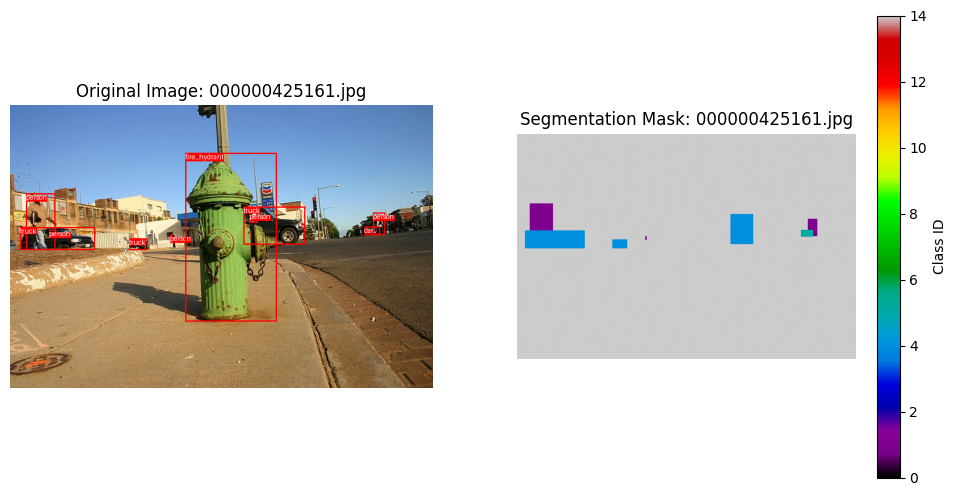

✔️ Used class_id 3(bus) at [183, 185, 282, 308]
✔️ Used class_id 11(pole) at [518, 0, 543, 331]


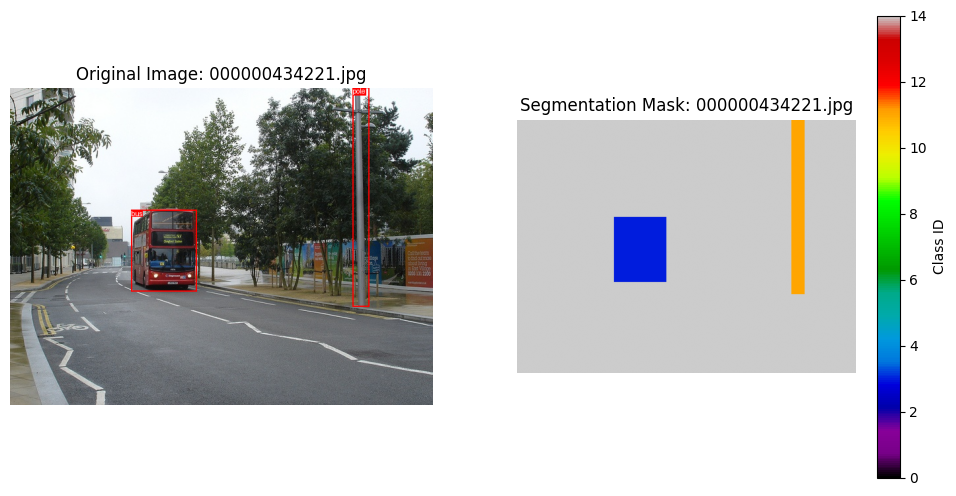

✔️ Used class_id 14(fire_hydrant) at [90, 40, 384, 632]
✔️ Used class_id 1(person) at [300, 0, 367, 138]
✔️ Used class_id 1(person) at [395, 0, 426, 144]


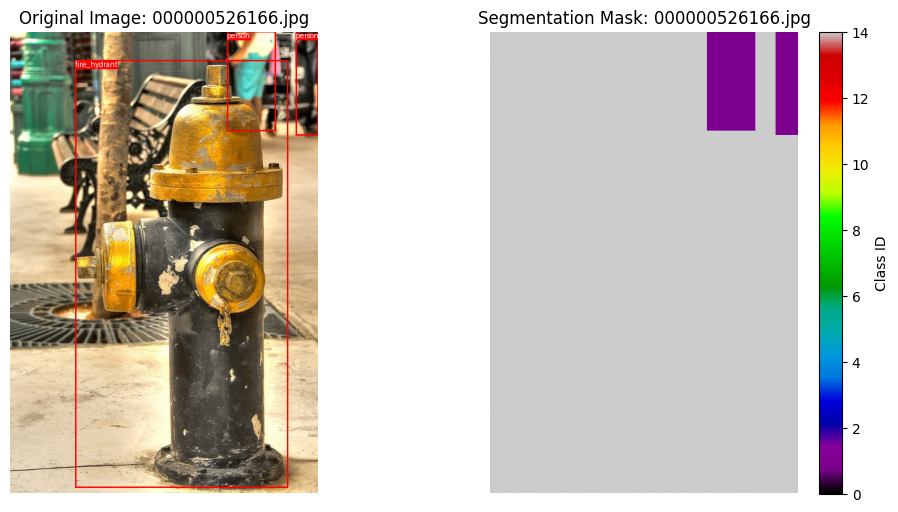

✔️ Used class_id 3(bus) at [256, 35, 340, 96]
✔️ Used class_id 1(person) at [436, 59, 456, 113]
✔️ Used class_id 14(fire_hydrant) at [188, 70, 286, 239]
✔️ Used class_id 1(person) at [416, 64, 426, 78]
✔️ Used class_id 1(person) at [407, 73, 420, 92]
✔️ Used class_id 1(person) at [419, 68, 434, 92]
✔️ Used class_id 11(pole) at [395, 0, 404, 94]
✔️ Used class_id 11(pole) at [99, 1, 113, 90]


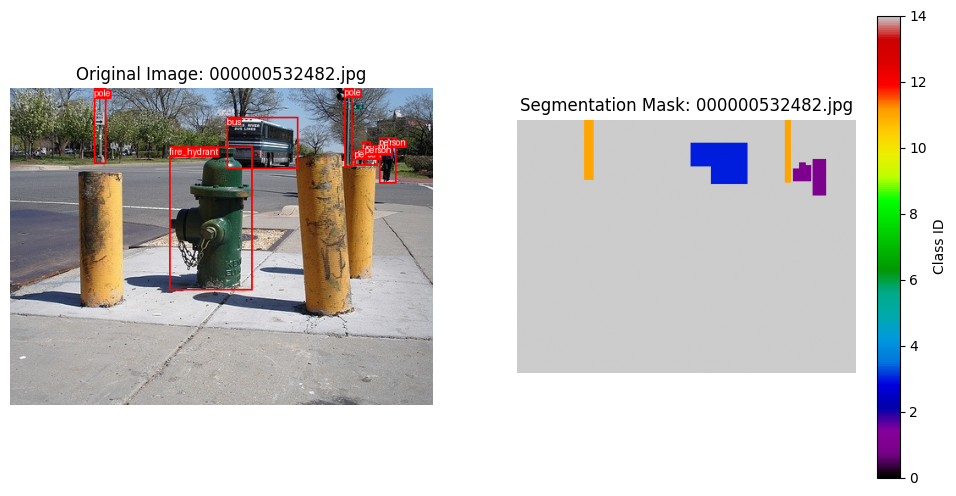

✔️ Used class_id 14(fire_hydrant) at [177, 174, 303, 431]


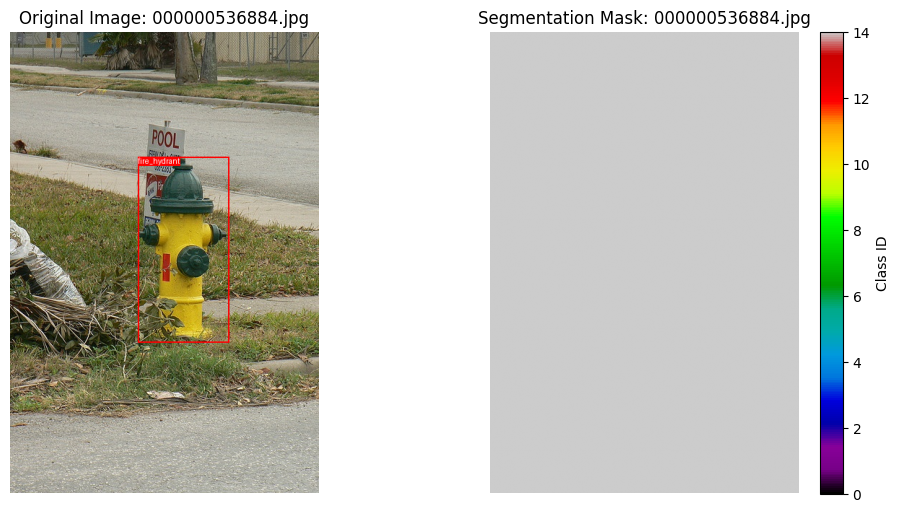

✔️ Used class_id 5(car) at [4, 342, 112, 437]
✔️ Used class_id 5(car) at [6, 231, 118, 363]
✔️ Used class_id 14(fire_hydrant) at [80, 166, 271, 580]
✔️ Used class_id 5(car) at [262, 318, 301, 381]
✔️ Used class_id 1(person) at [349, 322, 368, 362]


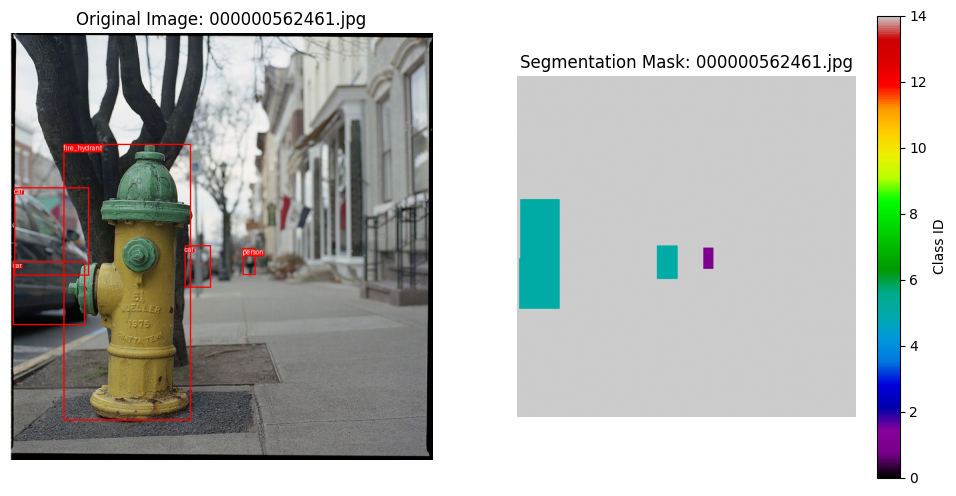

✔️ Used class_id 2(bicycle) at [91, 72, 305, 473]


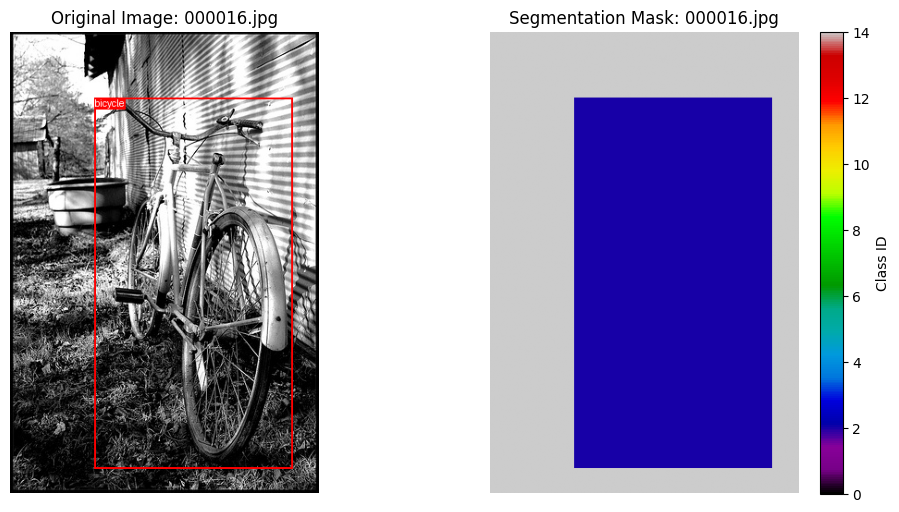

✔️ Used class_id 3(bus) at [43, 66, 279, 363]


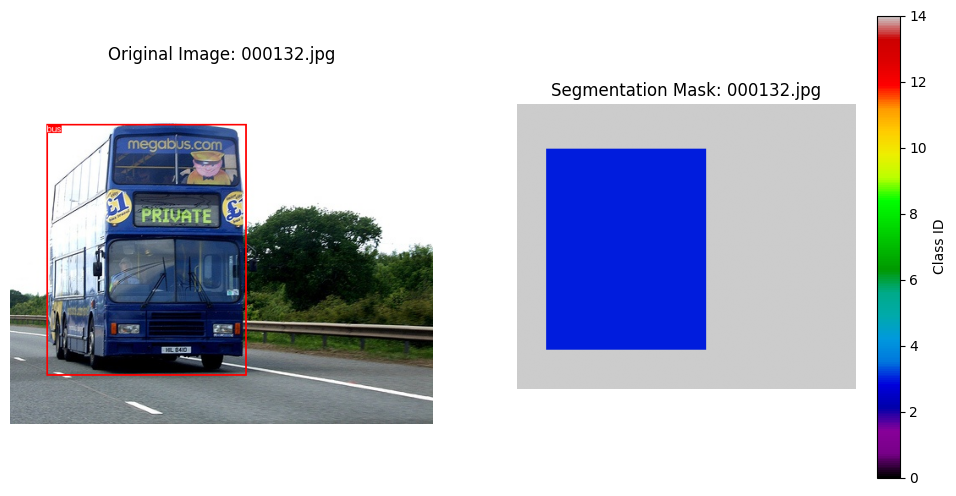

✔️ Used class_id 1(person) at [485, 174, 500, 280]
✔️ Used class_id 1(person) at [443, 163, 479, 283]
✔️ Used class_id 1(person) at [419, 153, 439, 240]
✔️ Used class_id 1(person) at [440, 156, 450, 230]
✔️ Used class_id 1(person) at [412, 163, 430, 248]
✔️ Used class_id 1(person) at [407, 194, 422, 251]
✔️ Used class_id 1(person) at [373, 156, 401, 266]
✔️ Used class_id 1(person) at [329, 169, 380, 252]
✔️ Used class_id 1(person) at [1, 153, 20, 305]
✔️ Used class_id 1(person) at [1, 110, 33, 244]
✔️ Used class_id 5(car) at [30, 141, 77, 205]
✔️ Used class_id 3(bus) at [67, 20, 382, 278]


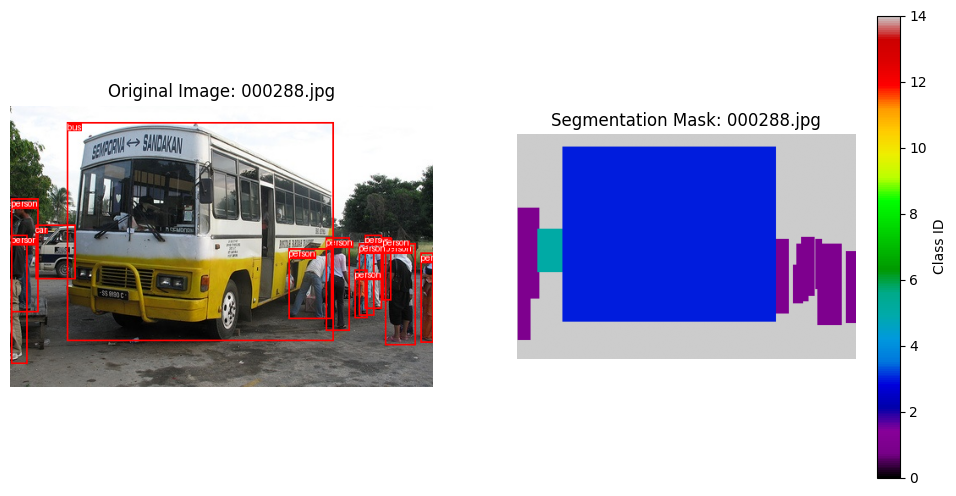

✔️ Used class_id 2(bicycle) at [15, 231, 296, 500]
✔️ Used class_id 1(person) at [57, 79, 323, 474]


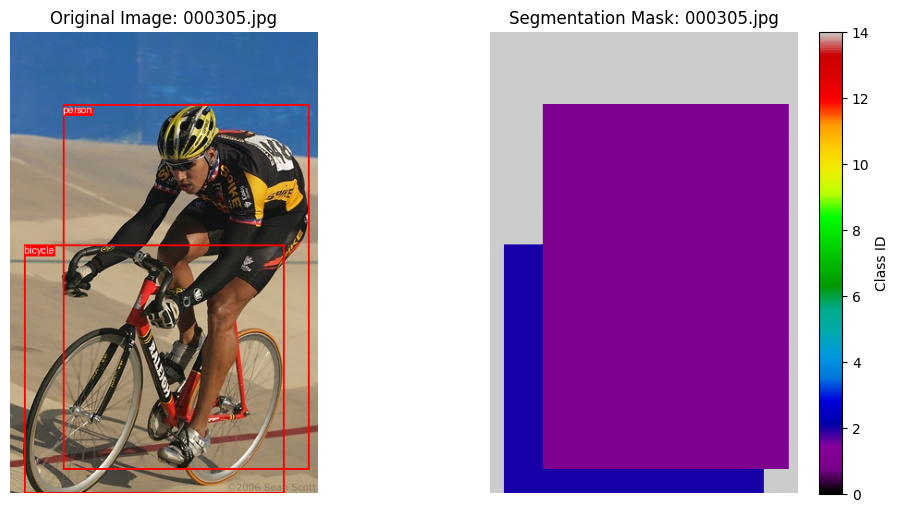

✔️ Used class_id 2(bicycle) at [194, 142, 352, 256]
✔️ Used class_id 2(bicycle) at [1, 142, 121, 269]
✔️ Used class_id 1(person) at [206, 54, 316, 238]
✔️ Used class_id 1(person) at [1, 66, 71, 247]
✔️ Used class_id 1(person) at [130, 92, 170, 207]
✔️ Used class_id 11(pole) at [111, 1, 140, 208]


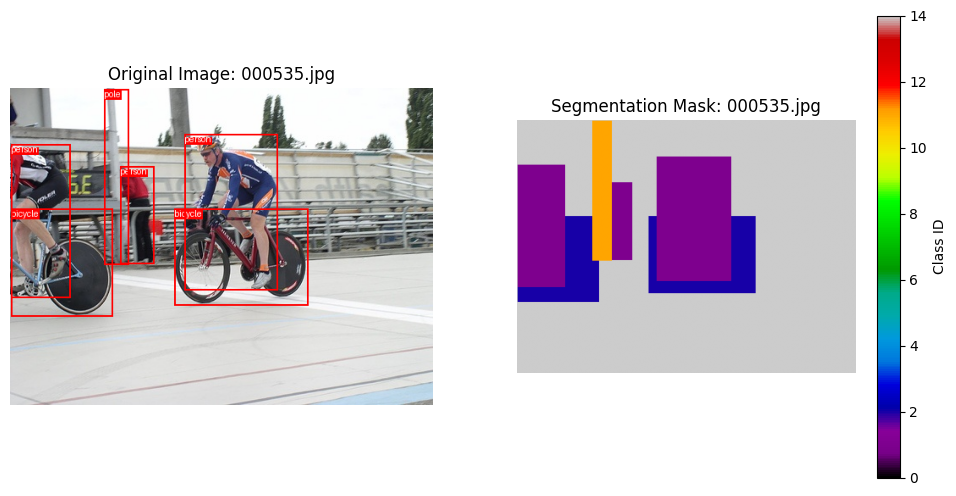

✔️ Used class_id 1(person) at [394, 199, 404, 223]
✔️ Used class_id 1(person) at [424, 199, 436, 220]
✔️ Used class_id 1(person) at [434, 196, 444, 220]
✔️ Used class_id 1(person) at [443, 195, 452, 220]
✔️ Used class_id 3(bus) at [28, 113, 353, 266]
✔️ Used class_id 5(car) at [1, 212, 28, 235]


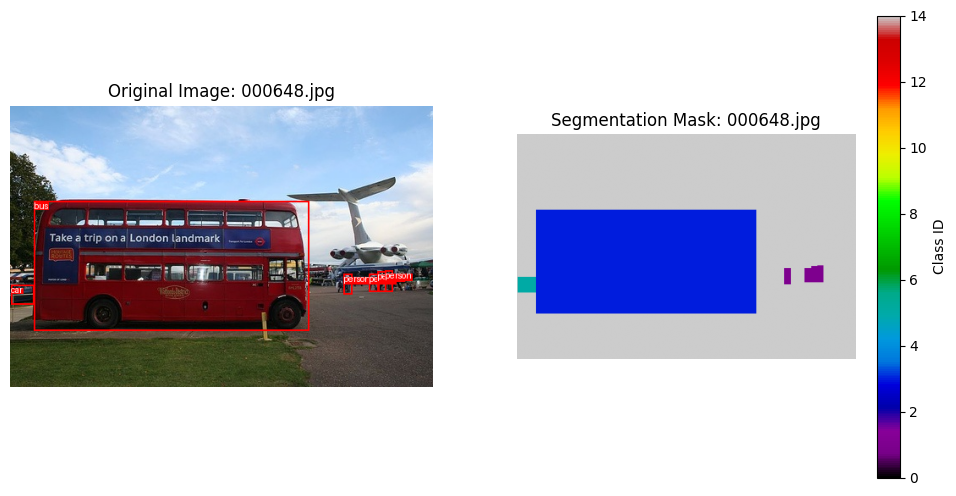

✔️ Used class_id 2(bicycle) at [48, 330, 268, 471]


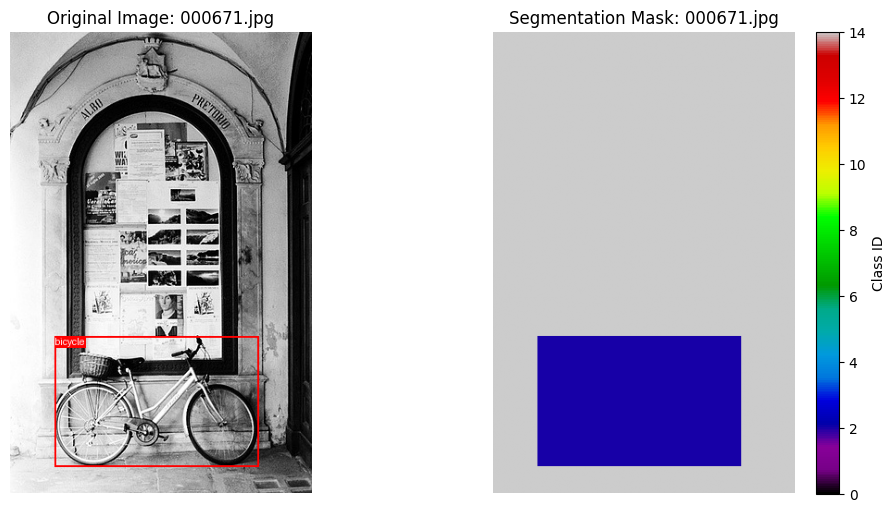

✔️ Used class_id 1(person) at [134, 65, 226, 366]
✔️ Used class_id 2(bicycle) at [1, 131, 42, 266]
✔️ Used class_id 6(motorbike) at [228, 128, 475, 361]


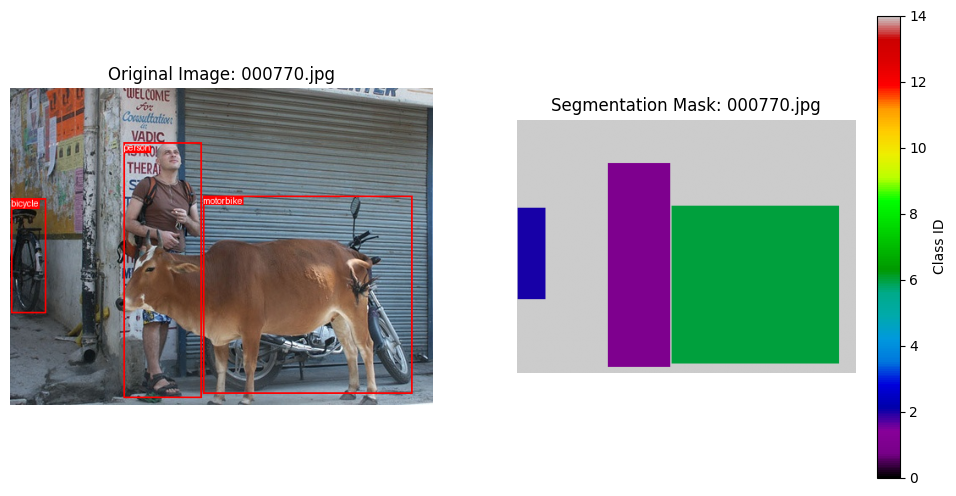

✔️ Used class_id 2(bicycle) at [72, 180, 281, 340]


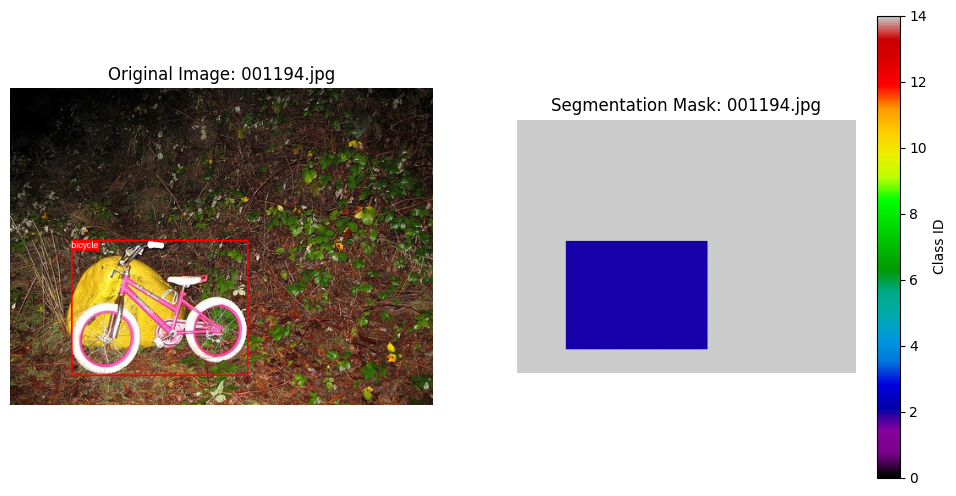

✔️ Used class_id 6(motorbike) at [93, 142, 358, 333]
✔️ Used class_id 2(bicycle) at [290, 148, 351, 177]
✔️ Used class_id 1(person) at [104, 74, 258, 310]
✔️ Used class_id 11(pole) at [234, 1, 249, 116]
✔️ Used class_id 11(pole) at [245, 0, 293, 127]
✔️ Used class_id 11(pole) at [73, 54, 83, 152]


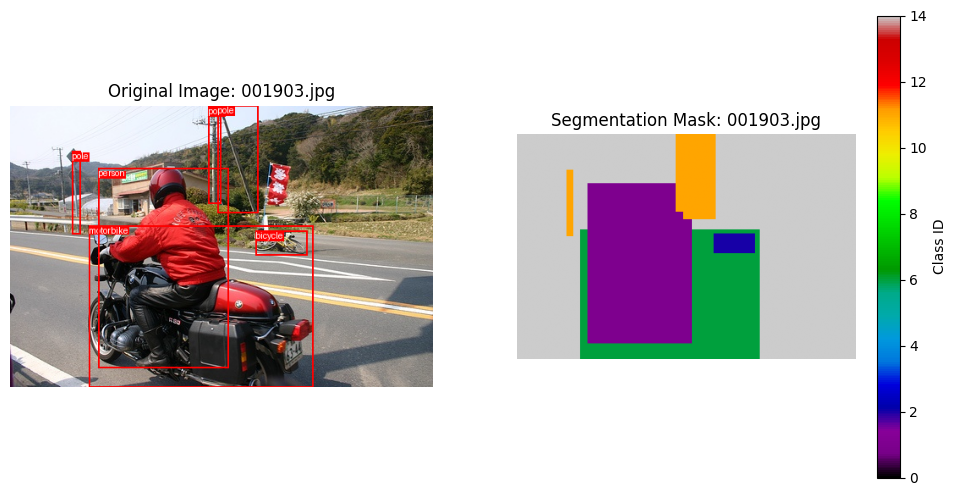

✔️ Used class_id 2(bicycle) at [153, 162, 240, 266]
✔️ Used class_id 1(person) at [155, 109, 266, 244]


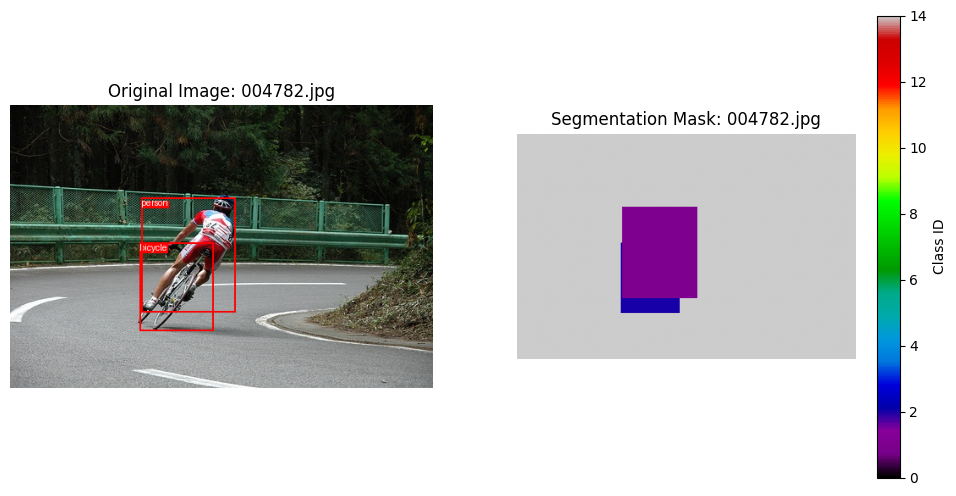

In [5]:
from PIL import Image, ImageDraw
import numpy as np
import os

def yolo_to_pixel_coords(bbox, img_width, img_height):
    cx, cy, w, h = bbox
    x1 = int((cx - w / 2) * img_width)
    y1 = int((cy - h / 2) * img_height)
    x2 = int((cx + w / 2) * img_width)
    y2 = int((cy + h / 2) * img_height)
    return x1, y1, x2, y2

def draw_mask_from_labels(image_path, label_path, id2label=None):
    image = Image.open(image_path).convert("L")
    w, h = image.size

    mask = np.ones((h, w), dtype=np.uint8)
    mask = mask * 255 # 讓背景代表白色

    with open(label_path, 'r') as f:
        lines = f.readlines()

    for line in lines:
        parts = line.strip().split()
        if len(parts) != 5:
            continue

        class_id = int(parts[0])
        bbox = list(map(float, parts[1:]))

        x1, y1, x2, y2 = yolo_to_pixel_coords(bbox, w, h)

        # 限制在圖片範圍內
        x1, y1 = max(x1, 0), max(y1, 0)
        x2, y2 = min(x2, w), min(y2, h)

        # 填滿 bbox 區域為對應類別編號
        mask[y1:y2, x1:x2] = class_id

        print(f"✔️ Used class_id {class_id}({id2label[class_id]}) at [{x1}, {y1}, {x2}, {y2}]")

    return Image.fromarray(mask.astype(np.uint8))

def draw_bboxes_on_image(image_path, label_path, id2label=None):
    """
    在原始圖片上繪製 YOLO 格式的邊界框。

    Args:
        image_path (str): 原始圖片的路徑。
        label_path (str): YOLO 格式標籤檔案的路徑。
        id2label (dict, optional): 類別 ID 到名稱的映射字典。用於顯示類別名稱。
                                     Defaults to None.

    Returns:
        PIL.Image.Image: 繪製了邊界框的 PIL 圖片物件。
    """
    # 打開原始圖片並轉換為 gray scale 格式
    image = Image.open(image_path).convert("RGB")
    img_width, img_height = image.size

    # 創建一個 ImageDraw 物件，用於在圖片上繪圖
    draw = ImageDraw.Draw(image)

    # 讀取標籤檔案
    with open(label_path, 'r') as f:
        lines = f.readlines()

    if id2label is None:
        print("WARNING: id2label is None. Class names will not be displayed.")

    # 遍歷每一行標籤
    for i, line in enumerate(lines):
        parts = line.strip().split()
        if len(parts) != 5:
            print(f"WARNING: Skipping malformed line {i+1}: {line.strip()}")
            continue

        # 解析類別 ID 和邊界框資訊
        class_id_from_yolo = int(parts[0])
        bbox_yolo = list(map(float, parts[1:]))

        # 將 YOLO 格式的邊界框轉換為像素座標
        x1, y1, x2, y2 = yolo_to_pixel_coords(bbox_yolo, img_width, img_height)

        # 限制邊界框在圖片範圍內
        x1, y1 = max(x1, 0), max(y1, 0)
        x2, y2 = min(x2, img_width), min(y2, img_height)

        # 獲取類別名稱（如果 id2label 字典存在）
        label_name = id2label.get(class_id_from_yolo, f"ID {class_id_from_yolo}") if id2label else f"ID {class_id_from_yolo}"

        # 在圖片上繪製矩形框
        # 你可以調整線條顏色 (fill), 線寬 (width)
        draw.rectangle([x1, y1, x2, y2], outline="red", width=2)

        # 在框的左上角添加類別名稱
        # 你可以調整字體大小和顏色，這裡我們用一個簡單的背景矩形讓文字更清晰
        text_bbox = draw.textbbox((x1, y1), label_name)
        draw.rectangle(text_bbox, fill="red") # 文字背景
        draw.text((x1, y1), label_name, fill="white") # 文字顏色

    return image

# ✅ 使用方法
if __name__ == "__main__":
  img_root_path = "/content/original/images/"
  label_root_path = "/content/original/labels/"
  mask_root_path = "/content/original/masks2/" # store new mask

  if not os.path.exists(mask_root_path):
    os.makedirs(mask_root_path)

  images = sorted(os.listdir(img_root_path))
  labels = sorted(os.listdir(label_root_path))

  for img_name, label in zip(images, labels):
    # get real image and labels
    img_path = os.path.join(img_root_path, img_name)
    label_path = os.path.join(label_root_path, label)

    try:
      seg_mask = draw_mask_from_labels(img_path, label_path, id2label)
      # plt.imsave(os.path.join(mask_root_path, img_name.replace(".jpg", ".png")), seg_mask.convert("L")) 會變彩色
      seg_mask.convert("L").save(os.path.join(mask_root_path, img_name.replace(".jpg", ".png")))

      # 顯示原始圖片 (可選，用於對比)
      original_image = Image.open(img_path).convert("RGB")
      image_with_bboxes = draw_bboxes_on_image(img_path, label_path, id2label)
      plt.figure(figsize=(12, 6))

      plt.subplot(1, 2, 1)
      plt.imshow(image_with_bboxes)
      plt.title(f"Original Image: {img_name}")
      plt.axis('off')

      # 顯示生成的分割遮罩
      plt.subplot(1, 2, 2)
      # 使用 `cmap='nipy_spectral'` 或其他能區分多種顏色的顏色映射表
      # `tab20` 只有 20 種顏色，如果你的類別多或顏色重疊，可能不明顯
      plt.imshow(np.array(seg_mask), cmap='nipy_spectral', vmin=0, vmax=len(id2label)-1)
      plt.colorbar(label='Class ID')
      plt.title(f"Segmentation Mask: {img_name}")
      plt.axis('off')

      plt.show()

    except Exception as e:
      print(f"ERROR processing {img_name}: {e}")

    # break # 處理完第一張就停止，如果要處理全部請移除此行


In [ ]:
IMAGE_SIZE = 512

import numpy as np
from PIL import Image, ImageDraw

def yolo_to_pixel_coords(bbox, img_width, img_height):
    """
    將 yolo bbox 轉換成左上角與右下角像素座標 (x1, y1, x2, y2)
    bbox: [cx, cy, w, h]（都是 normalized [0~1]）
    """
    cx, cy, w, h = bbox
    x1 = int((cx - w / 2) * img_width)
    y1 = int((cy - h / 2) * img_height)
    x2 = int((cx + w / 2) * img_width)
    y2 = int((cy + h / 2) * img_height)
    return x1, y1, x2, y2

def convert_mask_with_multiple_labels(binary_mask: Image.Image, label_lines: list):
    binary_np = np.array(binary_mask.convert("L"))
    h, w = binary_np.shape
    final_mask = np.ones((h, w), dtype=np.uint8) * 255 # 白色當背景

    for line in label_lines:
        parts = line.strip().split()
        if len(parts) != 5:
            continue
        class_id = int(parts[0])
        bbox = list(map(float, parts[1:]))
        x1, y1, x2, y2 = yolo_to_pixel_coords(bbox, w, h)

        # 限制在圖片範圍內
        x1, y1 = max(x1, 0), max(y1, 0)
        x2, y2 = min(x2, w), min(y2, h)

        region = binary_np[y1:y2, x1:x2]
        region_mask = (region == 0)

        # 避免誤判
        region_area = (y2 - y1) * (x2 - x1)
        mask_ratio = region_mask.sum() / region_area if region_area > 0 else 0

        # 加入遮罩比例條件，例如限制最少只能有 45% 為黑 (debug 用)
        if mask_ratio >= 0.45:
            final_mask[y1:y2, x1:x2][region_mask] = class_id
            # print(f"✔️ Used class_id {class_id} at [{x1}, {y1}, {x2}, {y2}] with {region_mask.sum()} pixels ({mask_ratio:.2%})")
        # else:
            # final_mask[y1:y2, x1:x2] = class_id # 用 bbox 資訊補強
            # print(f"⚠️ Replace the bbox info for class_id {class_id} due to too few pixels ({region_mask.sum()}) or too low ratio ({mask_ratio:.2%})")


    return Image.fromarray(final_mask)


# match each image to corresponding mask
class SemanticSegmentationDatasetv1(Dataset):
    """Image (semantic) segmentation dataset."""

    def __init__(self, root_dir, feature_extractor):
        """
        Args:
            root_dir (string): Root directory of the dataset containing the images + annotations(masks).
            feature_extractor: Huggingface SegFormerFeatureExtractor
        """
        self.root_dir = root_dir
        self.image_processor = feature_extractor

        # combine next-level directory
        self.img_dir = os.path.join(self.root_dir, "images")
        self.ann_dir = os.path.join(self.root_dir, "masks")
        self.label_dir = os.path.join(self.root_dir, "labels")

        # read images
        image_file_names = []
        for root, dirs, files in os.walk(self.img_dir):
          image_file_names.extend(files)
        self.images = sorted(image_file_names)

        # read annotations
        annotation_file_names = []
        for root, dirs, files in os.walk(self.ann_dir):
          annotation_file_names.extend(files)
        self.annotations = sorted(annotation_file_names)

        # read labels
        label_file_names = []
        for root, dirs, files in os.walk(self.label_dir):
          label_file_names.extend(files)
        self.labels = sorted(label_file_names)

    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):

        image = Image.open(os.path.join(self.img_dir, self.images[idx]))  # images
        raw_mask = Image.open(os.path.join(self.ann_dir, self.annotations[idx])).convert('L') # segmentation

        # 讀入多行 label
        with open(os.path.join(self.label_dir, self.labels[idx]), 'r') as f:
            label_lines = f.readlines()

        # 轉換成多類別語意分割 mask
        # 看起來這個 mask 不能吃 RGB
        mask = convert_mask_with_multiple_labels(raw_mask, label_lines)

        # randomly crop + pad both image and segmentation map to same size
        # 重點是送入這裡
        encoded_inputs = self.image_processor(image, mask, return_tensors="pt")

        for k,v in encoded_inputs.items():
          encoded_inputs[k].squeeze_() # remove batch dimension

        return encoded_inputs

In [7]:
from transformers import SegformerImageProcessor
from torch.utils.data import Subset
from sklearn.model_selection import train_test_split

root_dir = '/content/original/'
image_processor = SegformerImageProcessor(reduce_labels=False)

dataset = SemanticSegmentationDatasetv1(root_dir, image_processor)

# wrap to dataloader
batch_size = 4
num_workers = 2
train_dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True, num_workers=num_workers)

print("Number of training examples:", len(dataset))

Number of training examples: 35


Examine the image and corresponding mask

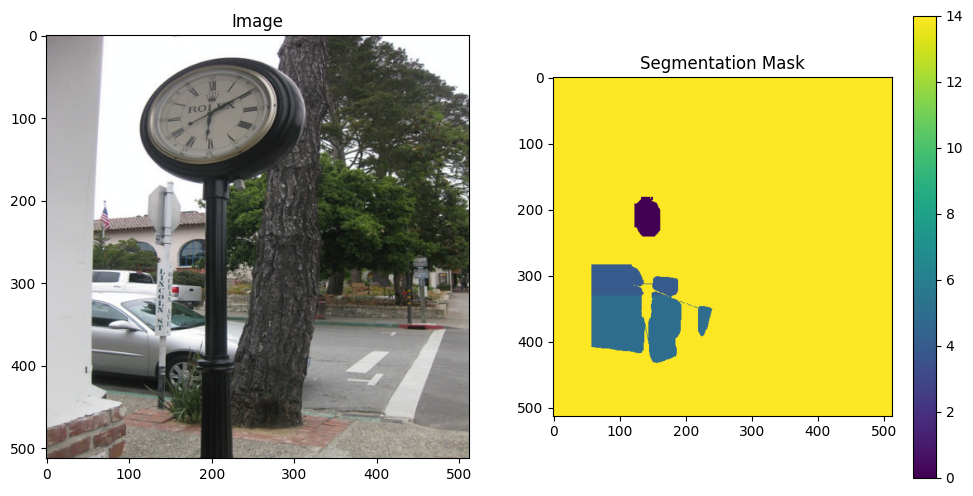

Mask shape: torch.Size([512, 512])
Unique values in mask: tensor([  0,   4,   5, 255])
 → 類別 0（stop_sign）：像素數 = 1993
 → 類別 4（truck）：像素數 = 4506
 → 類別 5（car）：像素數 = 11445
 → 類別 255（未知）：像素數 = 244200


In [8]:
sample = dataset[0]
image = sample['pixel_values'].permute(1, 2, 0).numpy()  # 如果你做了 transform，會是 tensor
mask = sample['labels']

# 若 mask 是 tensor，轉 numpy
mask_np = mask.cpu().numpy()

# 顯示圖像和 mask
mean = np.array([0.485, 0.456, 0.406])
std  = np.array([0.229, 0.224, 0.225])
image_denormalized = (image * std + mean) * 255  # 還原到原本 RGB
image_denormalized = np.clip(image_denormalized, 0, 255).astype(np.uint8)

plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.imshow(image_denormalized)
plt.title("Image")

plt.subplot(1, 2, 2)
plt.imshow(mask_np, vmin=0, vmax=len(id2label)-1)
plt.title("Segmentation Mask")
plt.colorbar()
plt.show()

print("Mask shape:", mask.shape)
print("Unique values in mask:", torch.unique(mask))
for cid in torch.unique(mask):
    print(f" → 類別 {cid.item()}（{id2label.get(cid.item(), '未知')}）：像素數 = {(mask == cid).sum().item()}")


define model

In [9]:
from transformers import SegformerForSemanticSegmentation

# define model
model = SegformerForSemanticSegmentation.from_pretrained("nvidia/mit-b0",
                              num_labels=15,
                              id2label=id2label,
                              label2id=label2id,
                            )

/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:104: UserWarning: 
Error while fetching `HF_TOKEN` secret value from your vault: 'Requesting secret HF_TOKEN timed out. Secrets can only be fetched when running from the Colab UI.'.
You are not authenticated with the Hugging Face Hub in this notebook.
If the error persists, please let us know by opening an issue on GitHub (https://github.com/huggingface/huggingface_hub/issues/new).
  warnings.warn(


config.json:   0%|          | 0.00/70.0k [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/14.4M [00:00<?, ?B/s]

Some weights of SegformerForSemanticSegmentation were not initialized from the model checkpoint at nvidia/mit-b0 and are newly initialized: ['decode_head.batch_norm.bias', 'decode_head.batch_norm.num_batches_tracked', 'decode_head.batch_norm.running_mean', 'decode_head.batch_norm.running_var', 'decode_head.batch_norm.weight', 'decode_head.classifier.bias', 'decode_head.classifier.weight', 'decode_head.linear_c.0.proj.bias', 'decode_head.linear_c.0.proj.weight', 'decode_head.linear_c.1.proj.bias', 'decode_head.linear_c.1.proj.weight', 'decode_head.linear_c.2.proj.bias', 'decode_head.linear_c.2.proj.weight', 'decode_head.linear_c.3.proj.bias', 'decode_head.linear_c.3.proj.weight', 'decode_head.linear_fuse.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Finetune  
* 因為 segformer 是透過 ADE20k 進行預訓練的，所以有些label他沒看過有機會亂猜，因此需要finetune適合這個資料的模型。
* 再來，由剛剛的測試發現 segformer 並不能很好的辨識 segmentation 的物件，因此可以考慮 finetune。

finetune a model with pytorch way

In [10]:
import evaluate

metric = evaluate.load("mean_iou")

In [11]:
import torch
from torch import nn
from sklearn.metrics import accuracy_score
from tqdm.notebook import tqdm

# define optimizer
optimizer = torch.optim.AdamW(model.parameters(), lr=0.00006)
# move model to GPU
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model.to(device)

all_epoch_loss = []
all_epoch_mean_iou = []
all_epoch_mean_accuracy = []

best_iou = 0.0  # 初始化最佳IoU
best_model_path = "best_model.pth"

model.train()
for epoch in range(80):  # loop over the dataset multiple times
  print("Epoch:", epoch)
  epoch_loss_total = 0
  batch_count = 0

  for idx, batch in enumerate(tqdm(train_dataloader)):
    # get the inputs;
    pixel_values = batch["pixel_values"].to(device)
    labels = batch["labels"].to(device)

    # zero the parameter gradients
    optimizer.zero_grad()

    # forward + backward + optimize
    outputs = model(pixel_values=pixel_values, labels=labels)
    loss, logits = outputs.loss, outputs.logits # 計算出的loss 跟 預測的標籤

    loss.backward()
    optimizer.step()

    # evaluate
    with torch.no_grad():
      # 避免跟 output 輸出形狀不同
      upsampled_logits = nn.functional.interpolate(logits, size=labels.shape[-2:], mode="bilinear", align_corners=False)
      # 得出最有可能的預測標籤
      predicted = upsampled_logits.argmax(dim=1)

      # note that the metric expects predictions + labels as numpy arrays
      metric.add_batch(predictions=predicted.detach().cpu().numpy(), references=labels.detach().cpu().numpy())

    # 累加loss
    epoch_loss_total += loss.item()
    batch_count += 1

  # 一個 epoch 完成後，計算整體 metrics
  metrics = metric.compute(
      num_labels=len(id2label),
      ignore_index=255,
      reduce_labels=False,
  )

  avg_loss = epoch_loss_total / batch_count
  all_epoch_loss.append(avg_loss)
  all_epoch_mean_iou.append(metrics["mean_iou"])
  all_epoch_mean_accuracy.append(metrics["mean_accuracy"])

  print(f"[Epoch {epoch}] Loss: {avg_loss:.4f} | Mean IoU: {metrics['mean_iou']:.4f} | Accuracy: {metrics['mean_accuracy']:.4f}")

  # 如果目前 IoU 更好，就存下這個模型
  if metrics["mean_iou"] >= best_iou:
      best_iou = metrics["mean_iou"]
      torch.save(model.state_dict(), best_model_path)
      print(f"✅ Saved new best model (IoU: {best_iou:.4f})")

Epoch: 0


  0%|          | 0/9 [00:00<?, ?it/s]

/usr/local/lib/python3.11/dist-packages/datasets/features/image.py:348: UserWarning: Downcasting array dtype int64 to int32 to be compatible with 'Pillow'
  warnings.warn(f"Downcasting array dtype {dtype} to {dest_dtype} to be compatible with 'Pillow'")


[Epoch 0] Loss: 2.5013 | Mean IoU: 0.0501 | Accuracy: 0.1301
✅ Saved new best model (IoU: 0.0501)
Epoch: 1


/root/.cache/huggingface/modules/evaluate_modules/metrics/evaluate-metric--mean_iou/9e450724f21f05592bfb0255fe2fa576df8171fa060d11121d8aecfff0db80d0/mean_iou.py:260: RuntimeWarning: invalid value encountered in divide
  acc = total_area_intersect / total_area_label


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 1] Loss: 1.9648 | Mean IoU: 0.2688 | Accuracy: 0.5007
✅ Saved new best model (IoU: 0.2688)
Epoch: 2


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 2] Loss: 1.4398 | Mean IoU: 0.3733 | Accuracy: 0.6023
✅ Saved new best model (IoU: 0.3733)
Epoch: 3


/root/.cache/huggingface/modules/evaluate_modules/metrics/evaluate-metric--mean_iou/9e450724f21f05592bfb0255fe2fa576df8171fa060d11121d8aecfff0db80d0/mean_iou.py:259: RuntimeWarning: invalid value encountered in divide
  iou = total_area_intersect / total_area_union


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 3] Loss: 1.1556 | Mean IoU: 0.4751 | Accuracy: 0.6339
✅ Saved new best model (IoU: 0.4751)
Epoch: 4


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 4] Loss: 0.8940 | Mean IoU: 0.5423 | Accuracy: 0.7020
✅ Saved new best model (IoU: 0.5423)
Epoch: 5


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 5] Loss: 0.6949 | Mean IoU: 0.5266 | Accuracy: 0.6770
Epoch: 6


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 6] Loss: 0.6870 | Mean IoU: 0.5502 | Accuracy: 0.7042
✅ Saved new best model (IoU: 0.5502)
Epoch: 7


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 7] Loss: 0.5425 | Mean IoU: 0.6289 | Accuracy: 0.7312
✅ Saved new best model (IoU: 0.6289)
Epoch: 8


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 8] Loss: 0.4837 | Mean IoU: 0.6297 | Accuracy: 0.7334
✅ Saved new best model (IoU: 0.6297)
Epoch: 9


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 9] Loss: 0.4875 | Mean IoU: 0.5727 | Accuracy: 0.7257
Epoch: 10


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 10] Loss: 0.3710 | Mean IoU: 0.7289 | Accuracy: 0.7596
✅ Saved new best model (IoU: 0.7289)
Epoch: 11


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 11] Loss: 0.3505 | Mean IoU: 0.7321 | Accuracy: 0.7646
✅ Saved new best model (IoU: 0.7321)
Epoch: 12


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 12] Loss: 0.3419 | Mean IoU: 0.6481 | Accuracy: 0.7526
Epoch: 13


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 13] Loss: 0.2766 | Mean IoU: 0.7379 | Accuracy: 0.7689
✅ Saved new best model (IoU: 0.7379)
Epoch: 14


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 14] Loss: 0.2630 | Mean IoU: 0.6671 | Accuracy: 0.7666
Epoch: 15


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 15] Loss: 0.2553 | Mean IoU: 0.6732 | Accuracy: 0.7694
Epoch: 16


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 16] Loss: 0.2202 | Mean IoU: 0.6725 | Accuracy: 0.7663
Epoch: 17


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 17] Loss: 0.2198 | Mean IoU: 0.7507 | Accuracy: 0.7751
✅ Saved new best model (IoU: 0.7507)
Epoch: 18


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 18] Loss: 0.2041 | Mean IoU: 0.7472 | Accuracy: 0.7737
Epoch: 19


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 19] Loss: 0.1722 | Mean IoU: 0.7600 | Accuracy: 0.7860
✅ Saved new best model (IoU: 0.7600)
Epoch: 20


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 20] Loss: 0.1892 | Mean IoU: 0.6912 | Accuracy: 0.7809
Epoch: 21


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 21] Loss: 0.1900 | Mean IoU: 0.7576 | Accuracy: 0.7831
Epoch: 22


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 22] Loss: 0.1807 | Mean IoU: 0.7585 | Accuracy: 0.7828
Epoch: 23


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 23] Loss: 0.1538 | Mean IoU: 0.6846 | Accuracy: 0.7789
Epoch: 24


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 24] Loss: 0.1596 | Mean IoU: 0.7606 | Accuracy: 0.7846
✅ Saved new best model (IoU: 0.7606)
Epoch: 25


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 25] Loss: 0.1798 | Mean IoU: 0.7298 | Accuracy: 0.7570
Epoch: 26


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 26] Loss: 0.1459 | Mean IoU: 0.7671 | Accuracy: 0.7873
✅ Saved new best model (IoU: 0.7671)
Epoch: 27


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 27] Loss: 0.1210 | Mean IoU: 0.7539 | Accuracy: 0.7796
Epoch: 28


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 28] Loss: 0.1151 | Mean IoU: 0.7607 | Accuracy: 0.7832
Epoch: 29


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 29] Loss: 0.1215 | Mean IoU: 0.7692 | Accuracy: 0.7884
✅ Saved new best model (IoU: 0.7692)
Epoch: 30


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 30] Loss: 0.1171 | Mean IoU: 0.7699 | Accuracy: 0.7925
✅ Saved new best model (IoU: 0.7699)
Epoch: 31


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 31] Loss: 0.1222 | Mean IoU: 0.7701 | Accuracy: 0.7881
✅ Saved new best model (IoU: 0.7701)
Epoch: 32


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 32] Loss: 0.1272 | Mean IoU: 0.7597 | Accuracy: 0.7851
Epoch: 33


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 33] Loss: 0.1345 | Mean IoU: 0.7783 | Accuracy: 0.7976
✅ Saved new best model (IoU: 0.7783)
Epoch: 34


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 34] Loss: 0.1315 | Mean IoU: 0.7628 | Accuracy: 0.7914
Epoch: 35


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 35] Loss: 0.1190 | Mean IoU: 0.7772 | Accuracy: 0.8016
Epoch: 36


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 36] Loss: 0.1558 | Mean IoU: 0.7671 | Accuracy: 0.7887
Epoch: 37


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 37] Loss: 0.1143 | Mean IoU: 0.7847 | Accuracy: 0.8079
✅ Saved new best model (IoU: 0.7847)
Epoch: 38


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 38] Loss: 0.0978 | Mean IoU: 0.7941 | Accuracy: 0.8129
✅ Saved new best model (IoU: 0.7941)
Epoch: 39


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 39] Loss: 0.0946 | Mean IoU: 0.8546 | Accuracy: 0.8961
✅ Saved new best model (IoU: 0.8546)
Epoch: 40


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 40] Loss: 0.0919 | Mean IoU: 0.8072 | Accuracy: 0.8297
Epoch: 41


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 41] Loss: 0.0971 | Mean IoU: 0.8176 | Accuracy: 0.8392
Epoch: 42


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 42] Loss: 0.0779 | Mean IoU: 0.8360 | Accuracy: 0.8477
Epoch: 43


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 43] Loss: 0.0739 | Mean IoU: 0.8595 | Accuracy: 0.8725
✅ Saved new best model (IoU: 0.8595)
Epoch: 44


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 44] Loss: 0.0725 | Mean IoU: 0.8395 | Accuracy: 0.8501
Epoch: 45


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 45] Loss: 0.0772 | Mean IoU: 0.8196 | Accuracy: 0.8393
Epoch: 46


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 46] Loss: 0.0601 | Mean IoU: 0.8887 | Accuracy: 0.9008
✅ Saved new best model (IoU: 0.8887)
Epoch: 47


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 47] Loss: 0.0769 | Mean IoU: 0.8266 | Accuracy: 0.8453
Epoch: 48


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 48] Loss: 0.0595 | Mean IoU: 0.9098 | Accuracy: 0.9225
✅ Saved new best model (IoU: 0.9098)
Epoch: 49


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 49] Loss: 0.0651 | Mean IoU: 0.9194 | Accuracy: 0.9610
✅ Saved new best model (IoU: 0.9194)
Epoch: 50


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 50] Loss: 0.0633 | Mean IoU: 0.8907 | Accuracy: 0.9022
Epoch: 51


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 51] Loss: 0.0571 | Mean IoU: 0.9157 | Accuracy: 0.9390
Epoch: 52


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 52] Loss: 0.0559 | Mean IoU: 0.8760 | Accuracy: 0.9021
Epoch: 53


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 53] Loss: 0.0570 | Mean IoU: 0.8706 | Accuracy: 0.8913
Epoch: 54


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 54] Loss: 0.0592 | Mean IoU: 0.9258 | Accuracy: 0.9400
✅ Saved new best model (IoU: 0.9258)
Epoch: 55


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 55] Loss: 0.0651 | Mean IoU: 0.8733 | Accuracy: 0.8841
Epoch: 56


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 56] Loss: 0.0586 | Mean IoU: 0.9342 | Accuracy: 0.9804
✅ Saved new best model (IoU: 0.9342)
Epoch: 57


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 57] Loss: 0.0518 | Mean IoU: 0.9380 | Accuracy: 0.9621
✅ Saved new best model (IoU: 0.9380)
Epoch: 58


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 58] Loss: 0.0482 | Mean IoU: 0.9338 | Accuracy: 0.9598
Epoch: 59


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 59] Loss: 0.0690 | Mean IoU: 0.8767 | Accuracy: 0.8870
Epoch: 60


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 60] Loss: 0.0486 | Mean IoU: 0.8825 | Accuracy: 0.8967
Epoch: 61


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 61] Loss: 0.0574 | Mean IoU: 0.9191 | Accuracy: 0.9365
Epoch: 62


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 62] Loss: 0.0406 | Mean IoU: 0.9289 | Accuracy: 0.9516
Epoch: 63


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 63] Loss: 0.0456 | Mean IoU: 0.9036 | Accuracy: 0.9235
Epoch: 64


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 64] Loss: 0.0518 | Mean IoU: 0.9353 | Accuracy: 0.9744
Epoch: 65


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 65] Loss: 0.0368 | Mean IoU: 0.8829 | Accuracy: 0.8912
Epoch: 66


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 66] Loss: 0.0431 | Mean IoU: 0.8836 | Accuracy: 0.8964
Epoch: 67


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 67] Loss: 0.0525 | Mean IoU: 0.9132 | Accuracy: 0.9251
Epoch: 68


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 68] Loss: 0.0381 | Mean IoU: 0.9463 | Accuracy: 0.9782
✅ Saved new best model (IoU: 0.9463)
Epoch: 69


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 69] Loss: 0.0419 | Mean IoU: 0.9345 | Accuracy: 0.9490
Epoch: 70


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 70] Loss: 0.0446 | Mean IoU: 0.9550 | Accuracy: 0.9894
✅ Saved new best model (IoU: 0.9550)
Epoch: 71


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 71] Loss: 0.0498 | Mean IoU: 0.8763 | Accuracy: 0.8872
Epoch: 72


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 72] Loss: 0.0380 | Mean IoU: 0.8881 | Accuracy: 0.8974
Epoch: 73


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 73] Loss: 0.0419 | Mean IoU: 0.9440 | Accuracy: 0.9846
Epoch: 74


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 74] Loss: 0.0414 | Mean IoU: 0.8807 | Accuracy: 0.8912
Epoch: 75


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 75] Loss: 0.0484 | Mean IoU: 0.9264 | Accuracy: 0.9641
Epoch: 76


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 76] Loss: 0.0394 | Mean IoU: 0.8876 | Accuracy: 0.8950
Epoch: 77


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 77] Loss: 0.0483 | Mean IoU: 0.9059 | Accuracy: 0.9173
Epoch: 78


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 78] Loss: 0.0367 | Mean IoU: 0.9248 | Accuracy: 0.9375
Epoch: 79


  0%|          | 0/9 [00:00<?, ?it/s]

[Epoch 79] Loss: 0.0322 | Mean IoU: 0.9361 | Accuracy: 0.9559


Visualize the train loss

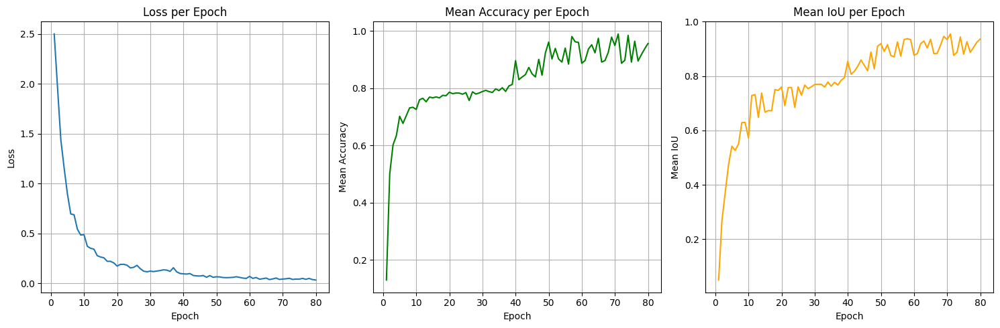

In [12]:
import matplotlib.pyplot as plt

epochs = range(1, len(all_epoch_loss) + 1)

plt.figure(figsize=(15, 5))

plt.subplot(1, 3, 1)
plt.plot(epochs, all_epoch_loss, label='Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Loss per Epoch')
plt.grid(True)

plt.subplot(1, 3, 2)
plt.plot(epochs, all_epoch_mean_accuracy, label='Mean Accuracy', color='green')
plt.xlabel('Epoch')
plt.ylabel('Mean Accuracy')
plt.title('Mean Accuracy per Epoch')
plt.grid(True)

plt.subplot(1, 3, 3)
plt.plot(epochs, all_epoch_mean_iou, label='Mean IoU', color='orange')
plt.xlabel('Epoch')
plt.ylabel('Mean IoU')
plt.title('Mean IoU per Epoch')
plt.grid(True)

plt.tight_layout()
plt.show()


inference

In [13]:
def palette():
    """obstacle palette that maps each class to RGB values."""
    return [[120, 120, 120], [180, 120, 120], [6, 230, 230], [80, 50, 50],
            [4, 200, 3], [120, 120, 80], [140, 140, 140], [204, 5, 255],
            [230, 230, 230], [4, 250, 7], [224, 5, 255], [235, 255, 7],
            [150, 5, 61], [120, 120, 70], [8, 255, 51]
            ]

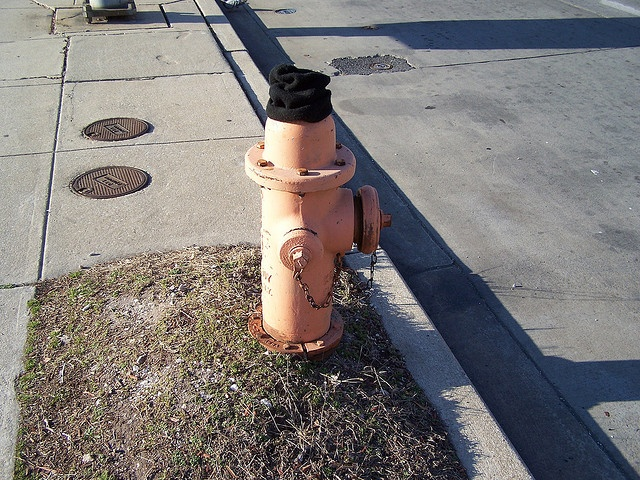

In [14]:
image = Image.open('/content/original/images/000000084200.jpg')
image

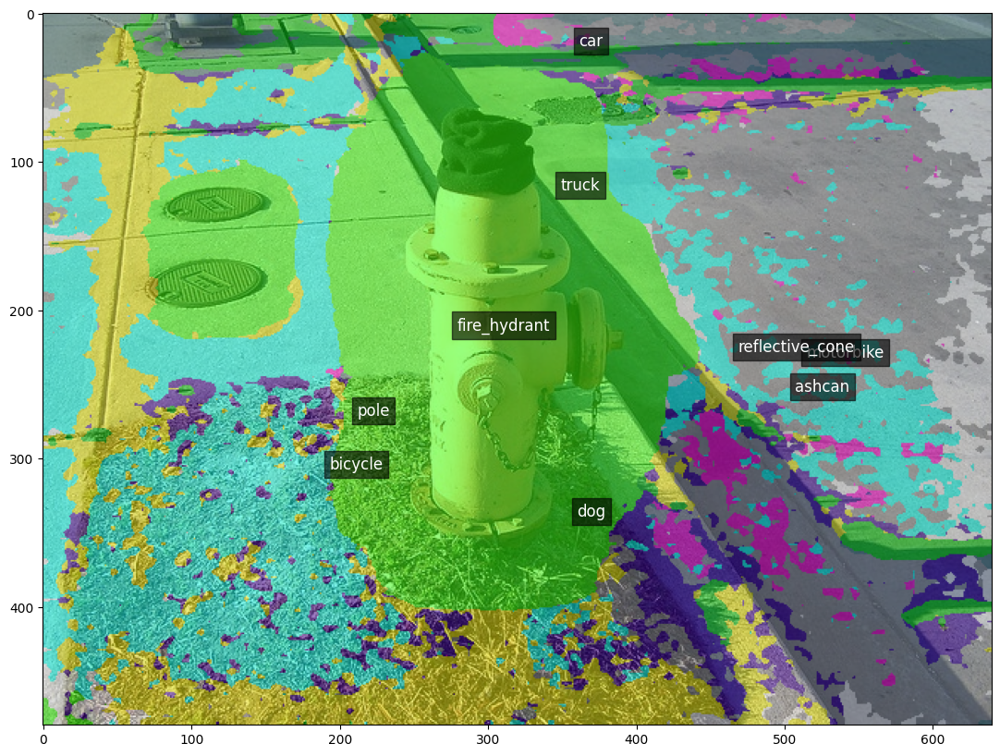

In [15]:
# 類別中心點標註（剛剛說的 center_of_mass）
from scipy.ndimage import center_of_mass

# load the model
model.load_state_dict(torch.load(best_model_path))
model.eval()

# load the image processor
image_processor = SegformerImageProcessor(reduce_labels=False)

# prepare the image for the model
pixel_values = image_processor(image, return_tensors="pt").pixel_values.to(device)

# forward pass
with torch.no_grad():
  outputs = model(pixel_values=pixel_values)

# 找尋最有可能的 output
predicted_segmentation_map = image_processor.post_process_semantic_segmentation(outputs, target_sizes=[image.size[::-1]])[0]
predicted_segmentation_map = predicted_segmentation_map.cpu().numpy()

# 空白調色盤
color_seg = np.zeros((predicted_segmentation_map.shape[0],
                  predicted_segmentation_map.shape[1], 3), dtype=np.uint8) # height, width, 3

# 取得調色盤
palette = np.array(palette())

for label, color in enumerate(palette):
    color_seg[predicted_segmentation_map == label, :] = color
# Convert to BGR
color_seg = color_seg[..., ::-1]

# Show image + mask
img = np.array(image) * 0.5 + color_seg * 0.5
img = img.astype(np.uint8)

plt.figure(figsize=(15, 10))
plt.imshow(img)

# 加入 label 資訊
unique_classes = np.unique(predicted_segmentation_map)  # 統計出現過的標籤
for cls_id in unique_classes:
    if cls_id == 255: continue  # 無效
    mask = (predicted_segmentation_map == cls_id).astype(np.uint8)
    if mask.sum() == 0 or mask.sum() <= 512:
        continue
    y, x = center_of_mass(mask) # 計算質心
    cls_name = model.config.id2label.get(cls_id, str(cls_id))   # 將類別 id 轉換為類別名稱
    plt.text(x, y, cls_name, fontsize=12, color='white',
              bbox=dict(facecolor='black', alpha=0.6))

plt.show()


測試生成圖片辨識效果

In [16]:
!unzip demo_obstacle.zip
!unzip demo_obstacle2.zip

Archive:  demo_obstacle.zip
   creating: demo_obstacle/
   creating: demo_obstacle/000000000064_jpg/
  inflating: demo_obstacle/000000000064_jpg/sample_00000.png  
  inflating: demo_obstacle/000000000064_jpg/sample_00001.png  
  inflating: demo_obstacle/000000000064_jpg/sample_00002.png  
  inflating: demo_obstacle/000000000064_jpg/sample_00003.png  
  inflating: demo_obstacle/000000000064_jpg/sample_00004.png  
  inflating: demo_obstacle/000000000064_jpg/sample_00005.png  
  inflating: demo_obstacle/000000000064_jpg/sample_00006.png  
  inflating: demo_obstacle/000000000064_jpg/sample_00007.png  
  inflating: demo_obstacle/000000000064_jpg/sample_00008.png  
   creating: demo_obstacle/000000000074_jpg/
  inflating: demo_obstacle/000000000074_jpg/grid-0000.png  
  inflating: demo_obstacle/000000000074_jpg/sample_00000.png  
  inflating: demo_obstacle/000000000074_jpg/sample_00001.png  
  inflating: demo_obstacle/000000000074_jpg/sample_00002.png  
  inflating: demo_obstacle/00000000007

directory: 001903_jpg


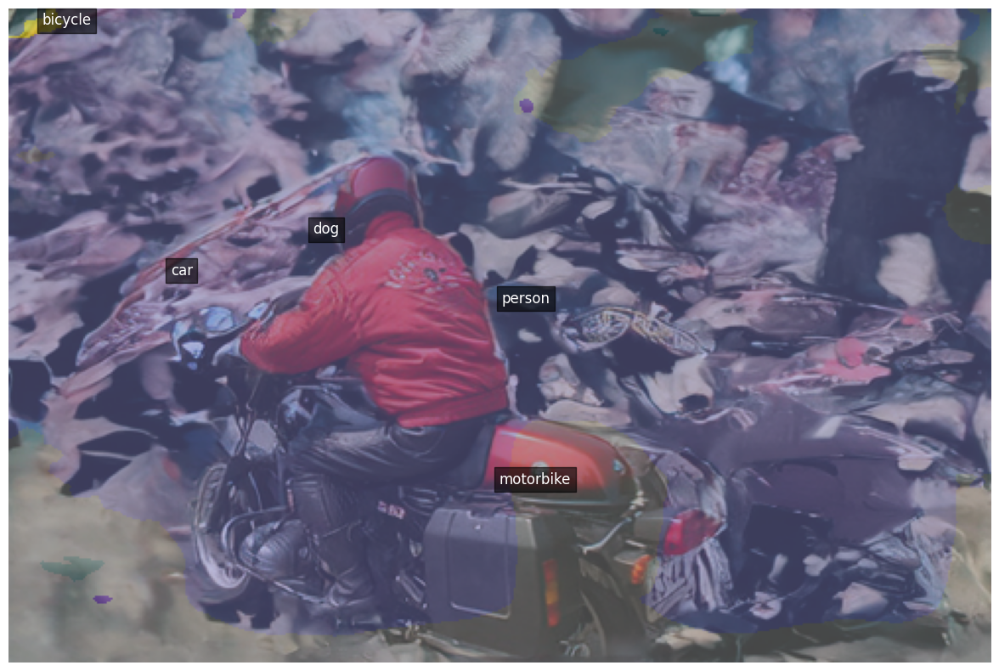

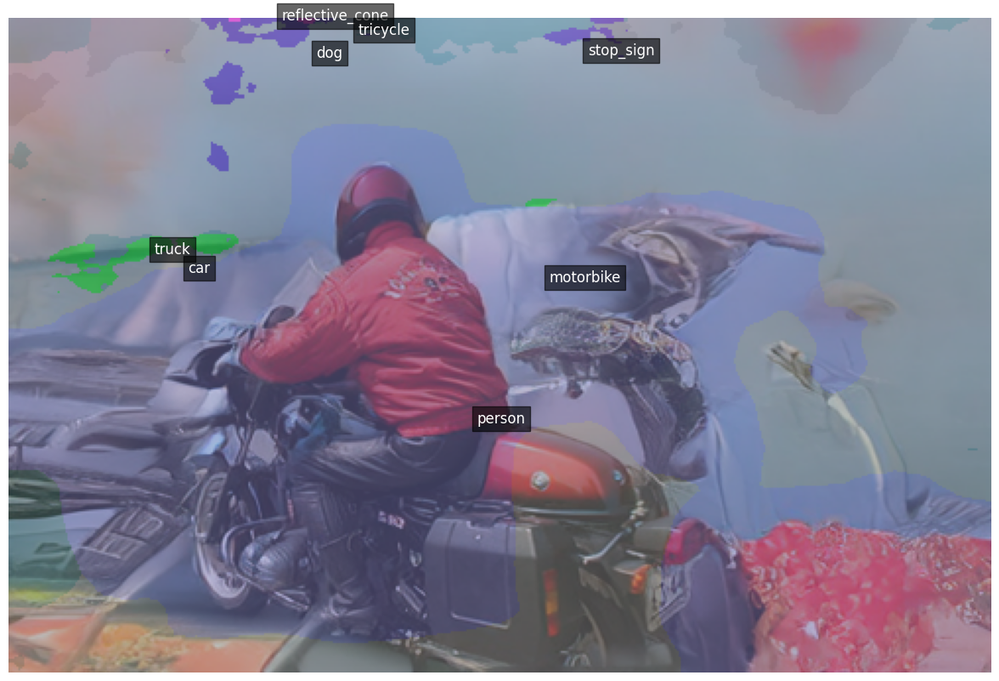

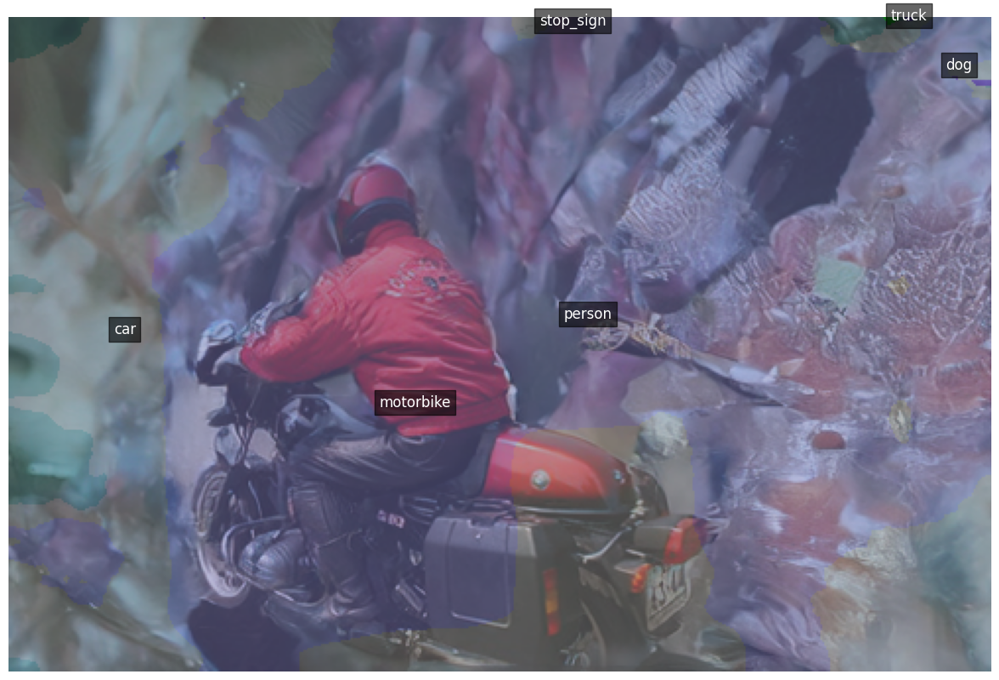

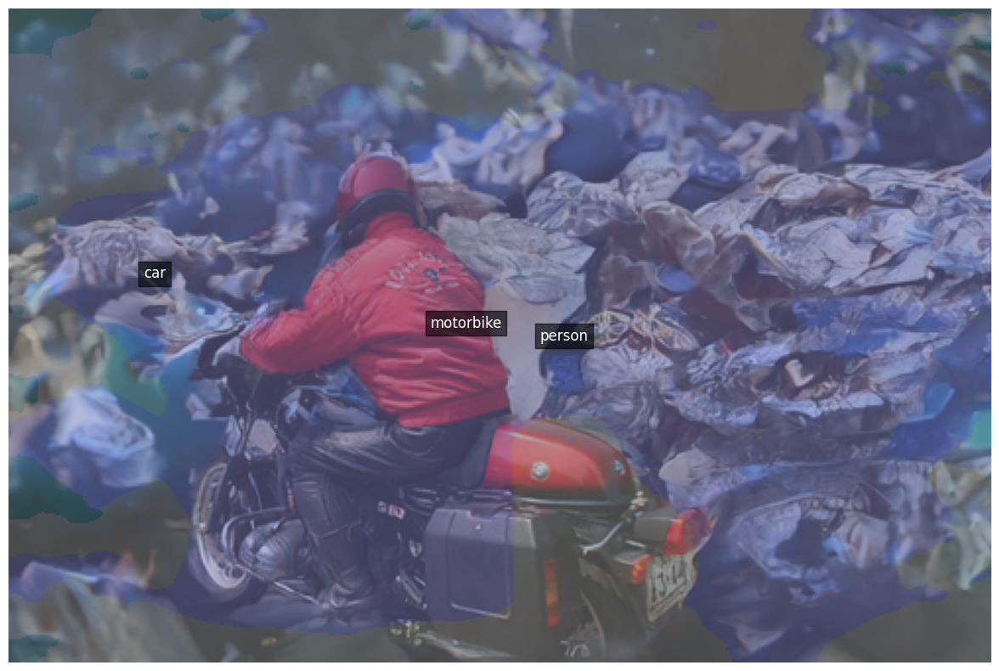

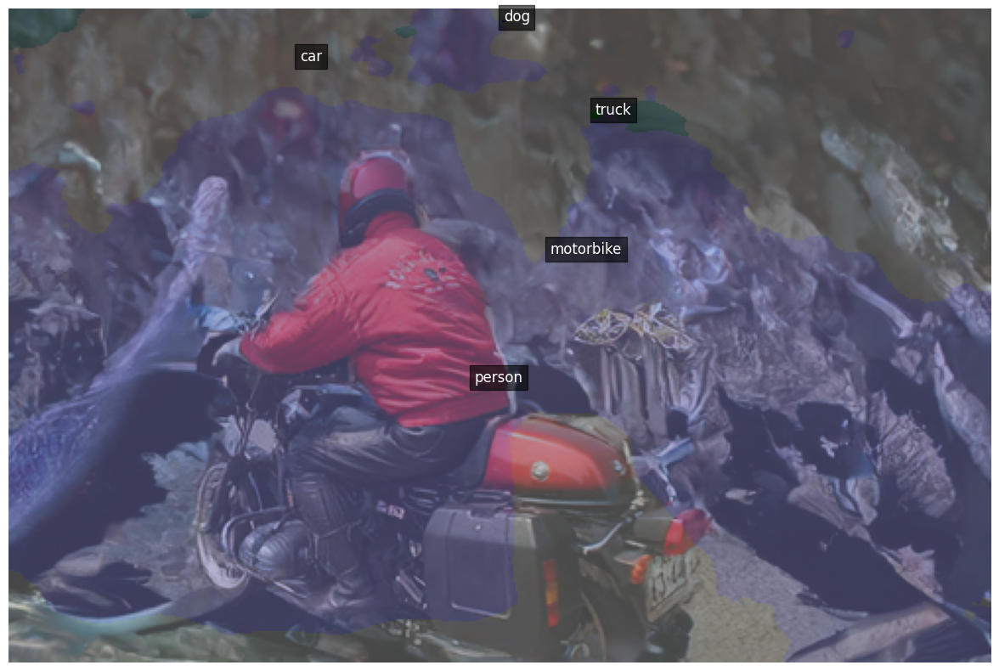

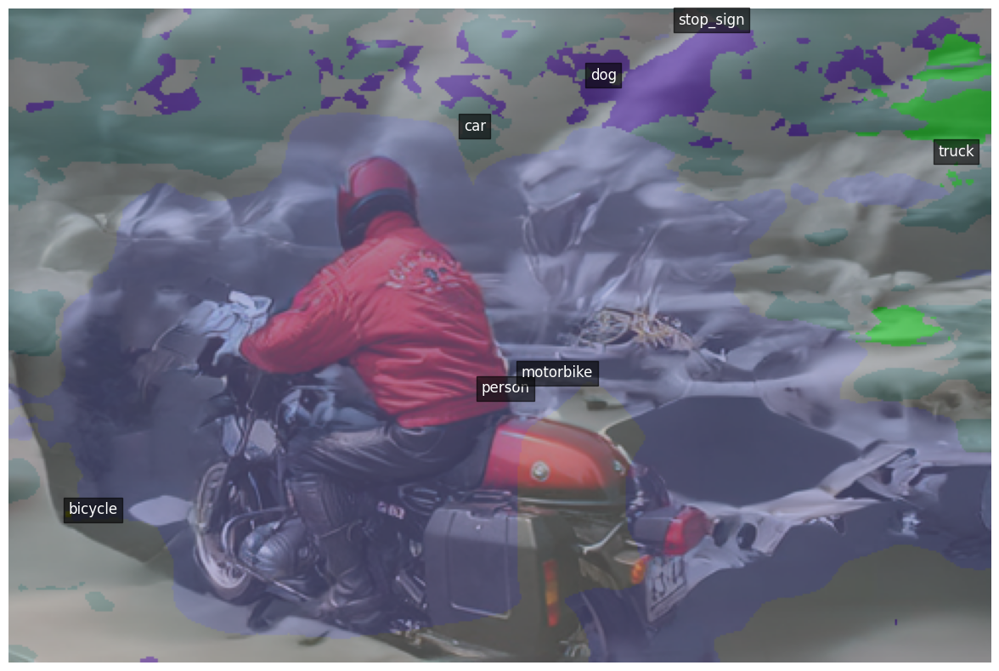

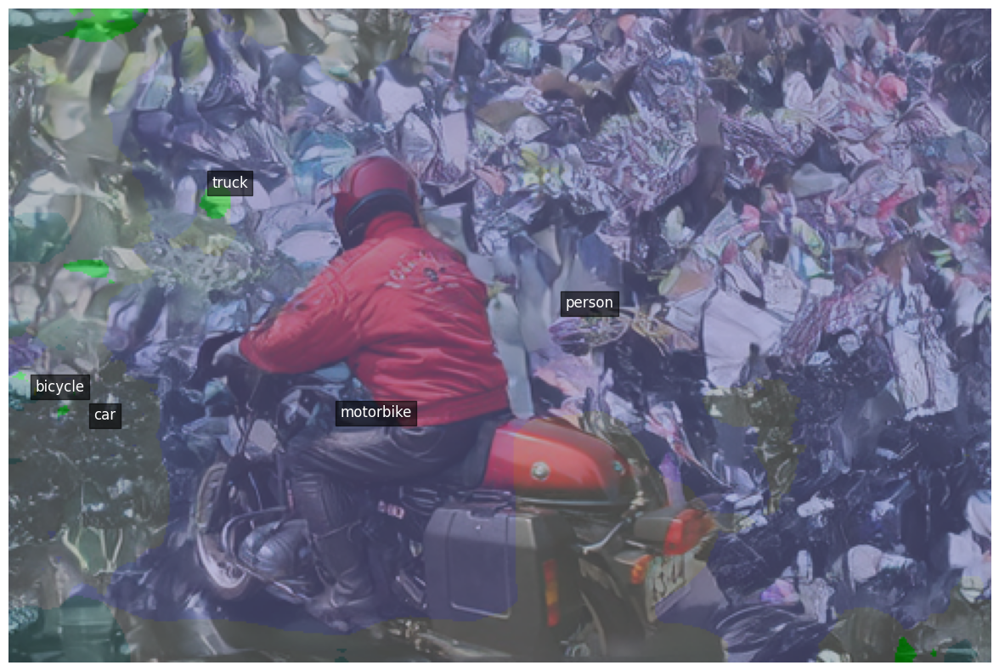

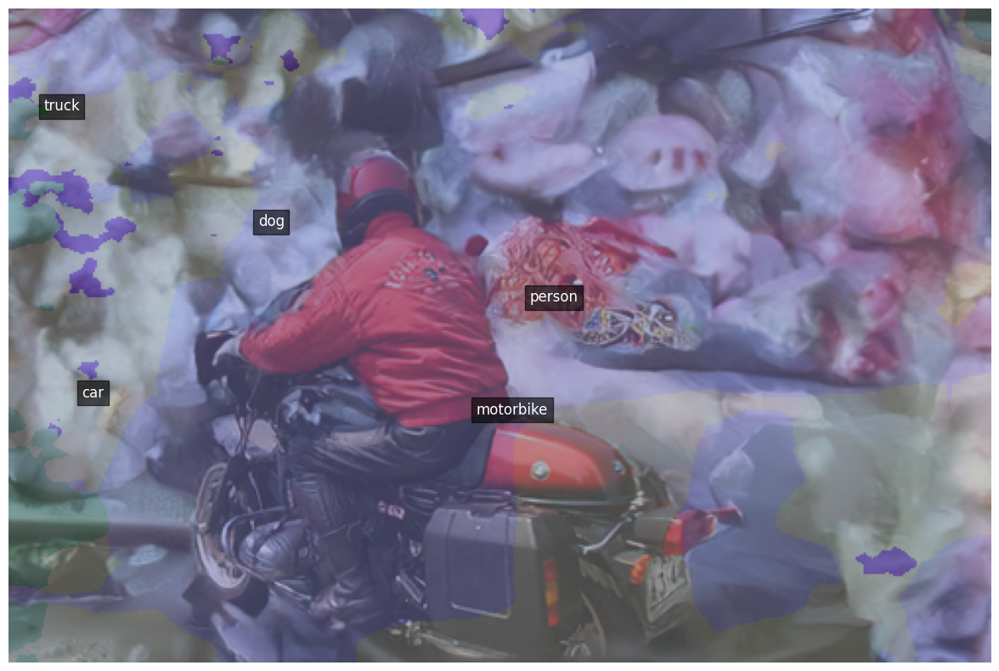

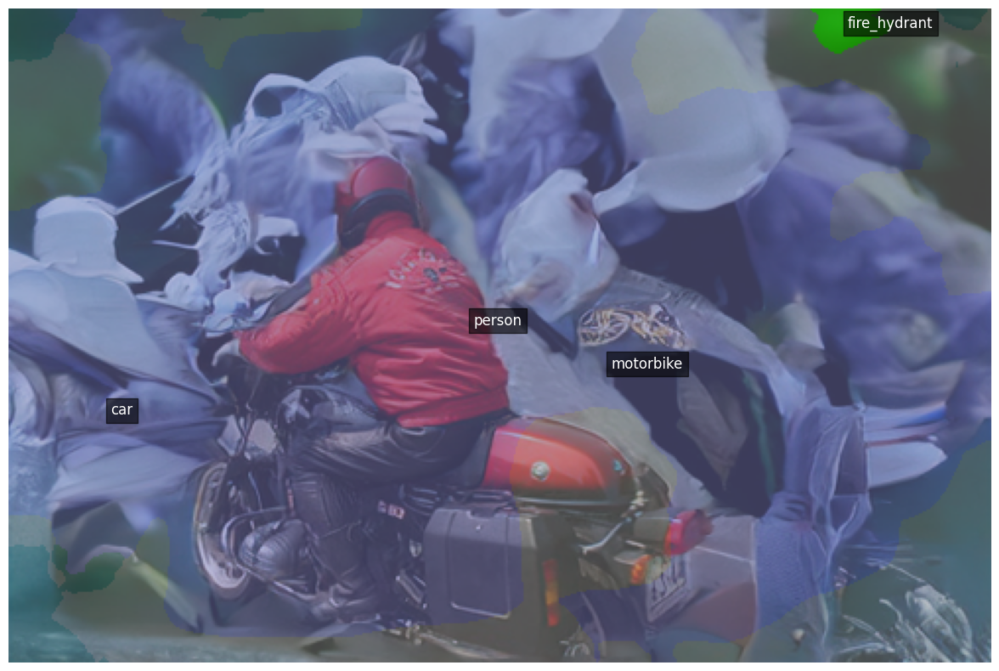

In [21]:
# palette_np = np.array(palette())

def test_generated_image(root_dir):
  """
    root_dir: directory store all generate images
  """
  images = os.listdir(root_dir)
  for image in images:
    if image.startswith('grid'):  # 遇到集合圖片就跳過
      continue

    image_path = os.path.join(root_dir, image)
    image = Image.open(image_path)

    # prepare the image for the model
    pixel_values = image_processor(image, return_tensors="pt").pixel_values.to(device)

    # forward pass
    with torch.no_grad():
      outputs = model(pixel_values=pixel_values)

    # 找尋最有可能的 output
    predicted_segmentation_map = image_processor.post_process_semantic_segmentation(outputs, target_sizes=[image.size[::-1]])[0]
    predicted_segmentation_map = predicted_segmentation_map.cpu().numpy()

    # 空白調色盤
    color_seg = np.zeros((predicted_segmentation_map.shape[0],
                      predicted_segmentation_map.shape[1], 3), dtype=np.uint8) # height, width, 3

    # 取得調色盤
    for label, color in enumerate(palette):
        color_seg[predicted_segmentation_map == label, :] = color
    # Convert to BGR
    color_seg = color_seg[..., ::-1]

    # Show image + mask
    img = np.array(image) * 0.5 + color_seg * 0.5
    img = img.astype(np.uint8)

    plt.figure(figsize=(15, 10))
    plt.imshow(img)

    # 加入 label 資訊
    unique_classes = np.unique(predicted_segmentation_map)  # 統計出現過的標籤
    for cls_id in unique_classes:
        if cls_id == 255: continue  # 無效
        mask = (predicted_segmentation_map == cls_id).astype(np.uint8)
        if mask.sum() == 0:
            continue
        y, x = center_of_mass(mask) # 計算質心
        cls_name = model.config.id2label.get(cls_id, str(cls_id))   # 將類別 id 轉換為類別名稱
        plt.text(x, y, cls_name, fontsize=12, color='white',
                  bbox=dict(facecolor='black', alpha=0.6))

    plt.axis('off')
    plt.show()

if __name__ == "__main__":
  dir = os.listdir('/content/demo_obstacle')
  # for d in dir:
  print(f"directory: {dir[7]}")
  test_generated_image(os.path.join('/content/demo_obstacle', dir[7]))
    # break